In [1]:
# ruff: noqa: F405, F403, E731
%load_ext autoreload
%autoreload 3
from python.mode_matching_common import *

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
LHO
From BSC coordination, the height of periscope is : 211.8 mm
From CAD model, the height of periscope is : 205.6892 mm
PSL periscope height is: 0.90098
LLO
From BSC coordination, the height of periscope is : 221.5 mm
From CAD model, the height of periscope is : 220.98 mm
PSL periscope height is: 0.84635


# Global vairable

In [2]:
site = 'LHO'
quality = 'HQ'

## Define periscope position

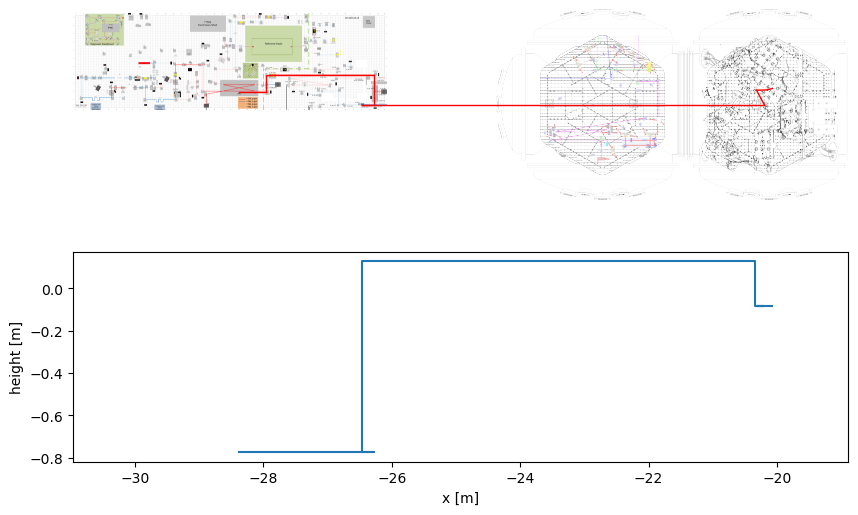

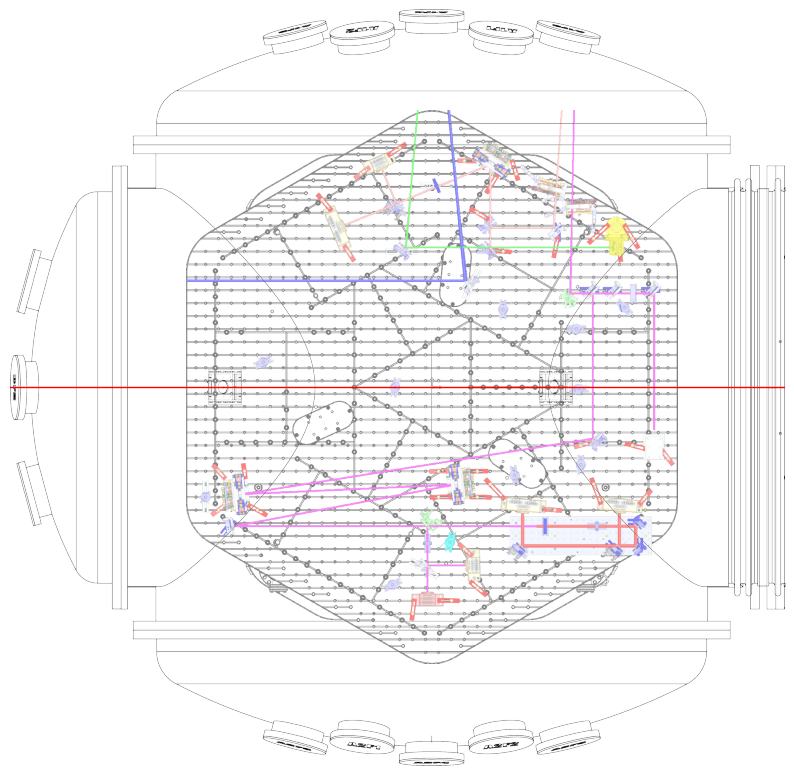

In [3]:
z_JAC_M1_dict = {'LLO':6.775,'LHO':6.825} # determine the periscope position in HAM1
z_JAC_M1 = z_JAC_M1_dict[site]
z_JAC_M5 = z_JAC_M1+1.3 # + 1.55 determine the periscope position in HAM1
JAC_M1 = Periscope(name='JAC_M1',pos=None, theta=0, quality=quality, bp_plot=True)
JAC_M5 = Periscope(name='JAC_M5',pos=None, theta=180, quality=quality, bp_plot=True)

PSL = PSL_group(site, quality,)
HAM1 = HAM1_group(site, quality,new=True)
HAM2 = HAM2_group(site,  quality)

PSL_to_HAM2 = PSL+HAM1+HAM2
PSL_to_HAM2.add_component_D(D=z_JAC_M1, component=JAC_M1)
PSL_to_HAM2.add_component_D(D=z_JAC_M5, component=JAC_M5)

fig, axs = plt.subplots(2,1,figsize=(10,6))
PSL_to_HAM2.draw(axs[0],'r')
PSL_to_HAM2.plot_height(fig, axs[1])
axs[1].set_xlim(axs[0].get_xlim())


fig, ax = plt.subplots(figsize=(10,10))
PSL_to_HAM2.draw(ax,'r')
xlim, ylim = PSL_to_HAM2['HAM1_chamber'].xlim, PSL_to_HAM2['HAM1_chamber'].ylim
ax.set_xlim(xlim)
ax.set_ylim(ylim)

pos_JAC_M1 = PSL_to_HAM2['JAC_M1'].pos + (PSL.origin_in_global - HAM1.origin_in_global)
pos_JAC_M5 = PSL_to_HAM2['JAC_M5'].pos + (PSL.origin_in_global - HAM1.origin_in_global)

# Initial condition for JAC modematching

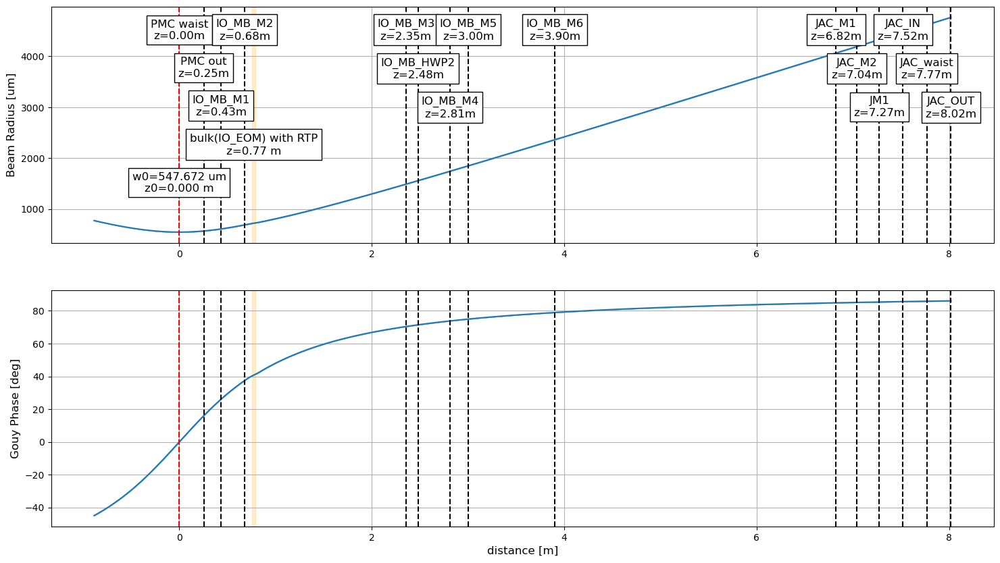

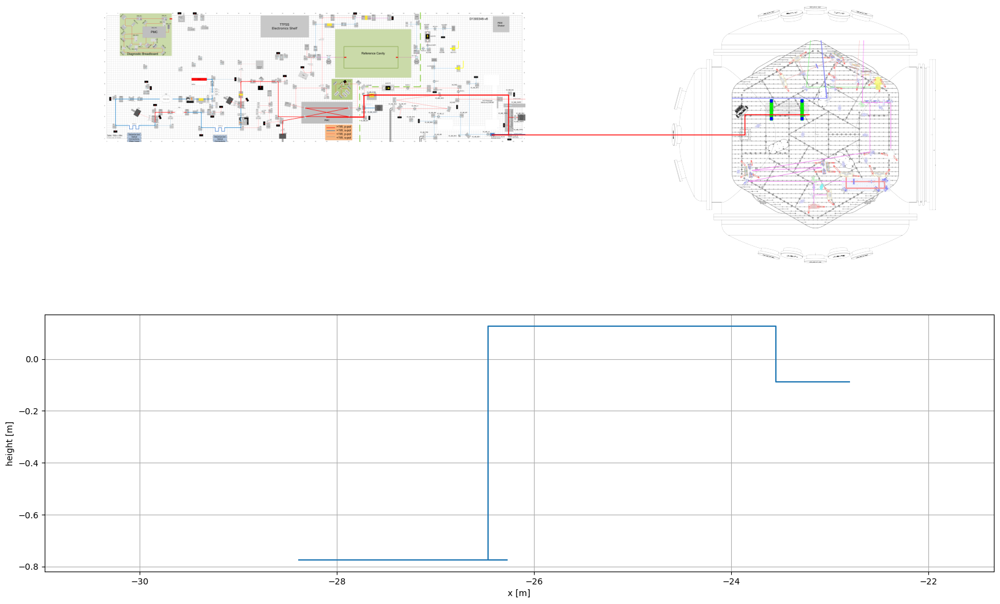

In [4]:
L_JACM2_JM1 = 233.75e-3
t_L_JM1_JAC_IN = 270e-3 - 1*inch
L_JAC_IN_to_JACR_M2 = 190e-3 
HAM1_beam_height = 4*inch
HAM1_periscope_height = PSL_periscope_top_BCSz[site] - (HAM1_ISI_center[site][2]+HAM1_beam_height)

PSL_for_MM = PSL_group(site, quality)
HAM1_for_MM = HAM1_group(site, quality, new=True)

JAC_M1 = Periscope(name='JAC_M1',pos=pos_JAC_M1, theta=0, quality=quality, bp_plot=True)
JAC_M2 = void(name='JAC_M2',pos=[*pos_JAC_M1[:2],pos_JAC_M1[2]-HAM1_periscope_height], bp_plot=True)
JM1 = TipTilt(name='JM1', pos=JAC_M2.pos+np.array([0,L_JACM2_JM1,0]))
JAC = JAC_cav(name='JAC', pos=JM1.pos+np.array([t_L_JM1_JAC_IN,0,0]),inputbeam_ang_deg=0,def_point='in')
JAC_in, JAC_out, JAC_CM1, JAC_CM2, JAC_waist, JAC_waist2 = JAC.get_node()

JAC_M4 = void(name='JAC_M4',pos=[*pos_JAC_M5[:2],pos_JAC_M1[2]-HAM1_periscope_height], bp_plot=True)
JAC_M5 = Periscope(name='JAC_M5',pos=pos_JAC_M5, theta=180, quality=quality, bp_plot=True)
for comp in [JAC_M1,JAC_M2,JM1,JAC_in,JAC,JAC_out]:
    HAM1_for_MM.add_component(comp, main_path_idx=-1)

JAC_connection_comp = [JAC_out,JAC_CM1,JAC_CM2,JAC_in]

for ii in range(len(JAC_connection_comp)-1):
    HAM1_for_MM.add_connection([JAC_connection_comp[ii],JAC_connection_comp[ii+1]])

PSL_to_JAC_for_MM = PSL_for_MM + HAM1_for_MM
_,_,_ = PSL_to_JAC_for_MM.plot_bp()


fig, axs = plt.subplots(2,1,figsize=(20,12))
PSL_to_JAC_for_MM.draw(axs[0],'r')
PSL_to_JAC_for_MM.plot_height(fig, axs[1])
axs[1].set_xlim(axs[0].get_xlim())
axs[1].grid()
fig.savefig(f'Figs/{site}/JAC_height_{site}.png')
fig.savefig(f'Figs/{site}/JAC_height_{site}.pdf')

# JAC modematching

Finding mode match solutions: 100%|██████████| 3/3 [00:00<00:00, 1542.21it/s]


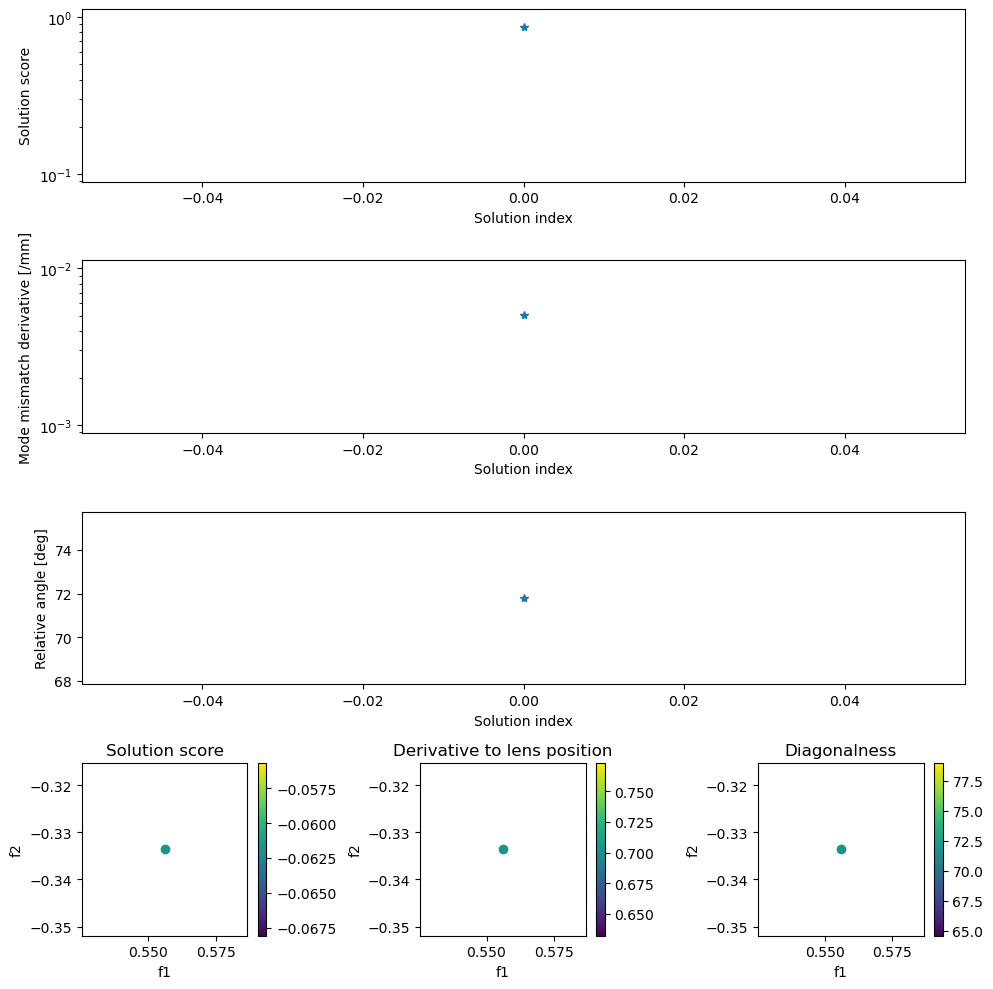

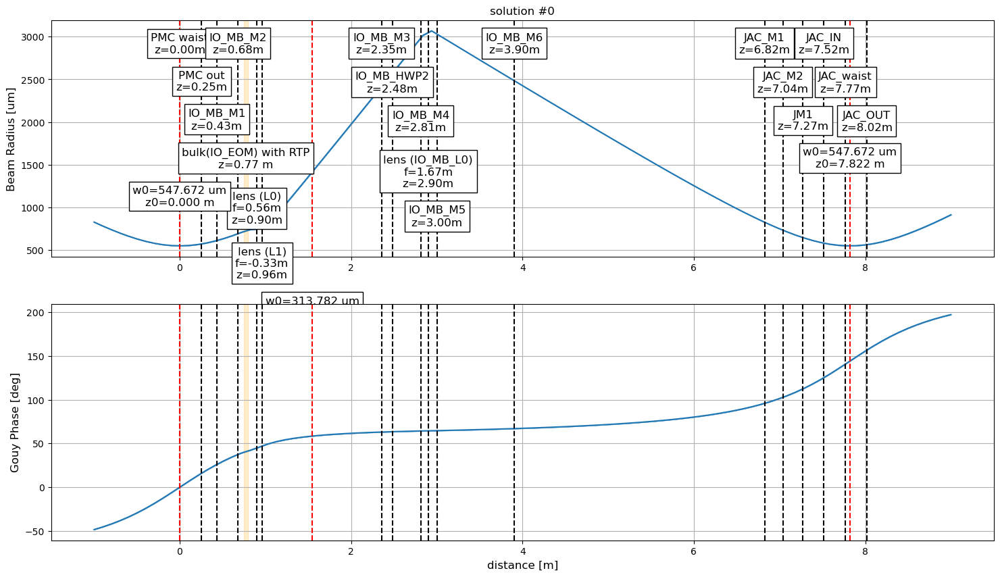

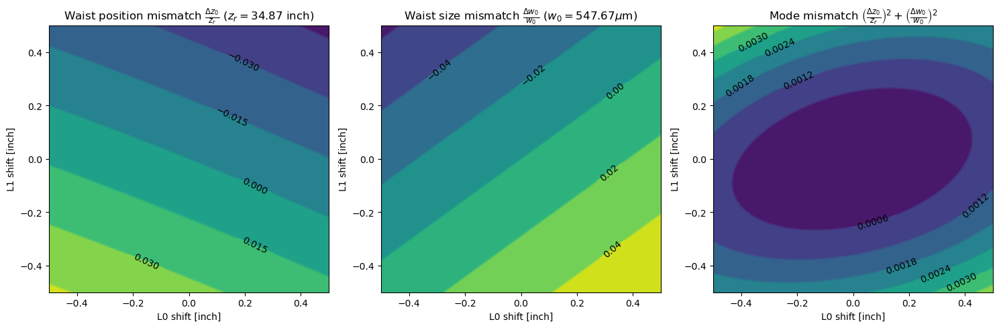

In [5]:
## Mode matching
def _Sellmeier(wavelength, A1, A2, A3, B1, B2, B3):
    l = wavelength*1e6
    n = np.sqrt(1 + A1*l**2/(l**2-B1) + A2 * l**2/(l**2-B2) + A3 * l**2/(l**2-B3))
    return n
coef_dict = {'corning_7980':{'A1':0.68374049400,'A2':0.42032361300,'A3':0.58502748000,'B1':0.00460352869,'B2':0.01339688560,'B3':64.49327320000}}
n_dict = {'corning_7980':{wavelength:_Sellmeier(wavelength, **coef_dict['corning_7980']) for wavelength in [1064e-9, 532e-9]}}
n_FS = n_dict['corning_7980'][1064e-9]

zz_JAC_MM = np.linspace(-1,9,100)
JAC_w0 = small_waist[0]

RoC2f = lambda RoC: RoC/(n_FS-1)
RoCs = np.array([250,  -150,])*1e-3 # https://dcc.ligo.org/LIGO-E2500026
# RoCs = np.array([-0.15, -0.2,-0.25,1,1.5,2])

f_list = np.array(RoCs)/(n_FS-1)
f_L0 = RoC2f(-0.15)
# f_L1 = RoC2f(0.5)
f_L2 = RoC2f(0.75)


bp_JACin = copy.deepcopy(PSL_to_JAC_for_MM.bp)
bp_JACin.debug = False  
bp_JACin.add_lens(z=2.9, name='IO_MB_L0', f=f_L2)
z0_target = [bp_JACin['JAC_waist'].z-0.1,bp_JACin['JAC_waist'].z+0.1]
# zlim = [[bp_JACin['IO_EOM'].z + 0.1, bp_JACin['IO_MB_L0'].z-0.1]]
zlim = [[bp_JACin['IO_EOM'].z + 0.1, bp_JACin['IO_EOM'].z + 0.3]]

mmt = bp.modematching_tool(f_list,zlim,w0_target=JAC_w0,z0_target=z0_target)
bp_list, best_mode_mm_list, lens_combo_list = mmt.find_modematch_solutions(bp=bp_JACin,grid_n=20,threshold=1e-2,lensnum_max=2)
sort_idx, JAC_MM_bp_plot, JAC_MM_2D_plot = mmt.show_MM_solutions(zz_JAC_MM,plot_num=5, mode_mm_acceptance=0.1,dzdw_angle_acceptance=250,dz_range=0.5*inch)



# Plot Modematch solution

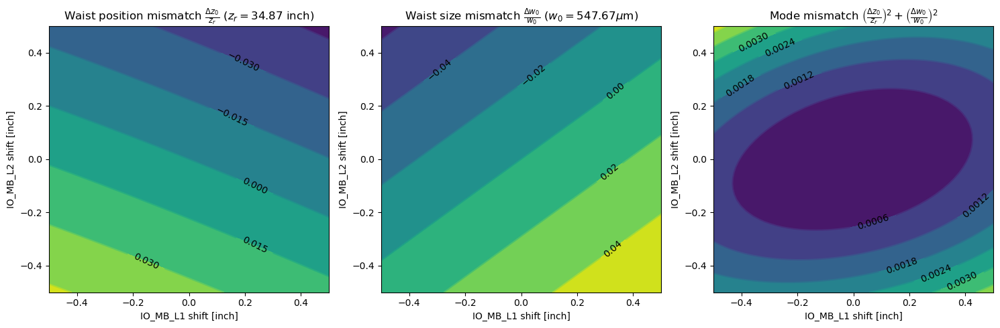

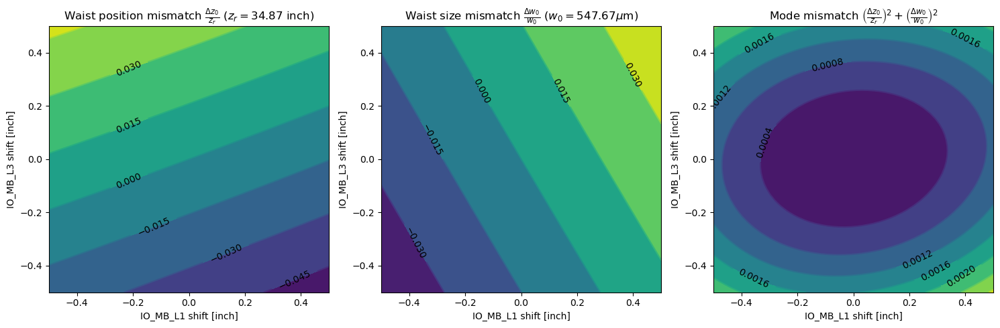

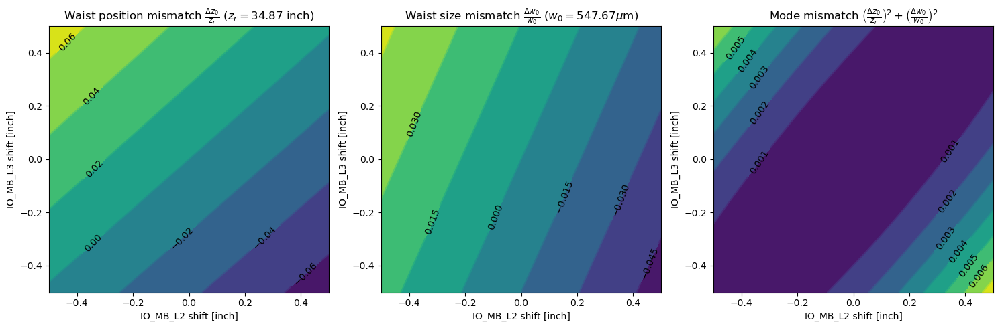

In [6]:
JAC_mm_solution = copy.deepcopy(bp_list[sort_idx[0]])
JAC_w, _, JAC_z, _ = JAC_mm_solution.get_output_waist()
JAC_delta_z = JAC_z - JAC_mm_solution['JAC_waist'].z
for optic in ['JM1','JAC_IN', 'JAC_OUT', 'JAC_waist']:
    JAC_mm_solution[optic].shift_component(JAC_delta_z)

for ii,lensname in enumerate(JAC_mm_solution.get_lens_namelist()):
    # JAC_mm_solution[lensname].plot= False
    JAC_mm_solution[lensname].name = 'IO_MB_L%d'%(ii+1)

lensname = JAC_mm_solution.get_lens_namelist()
lenscomb = [(lensname[0],lensname[1]),(lensname[0],lensname[2]),(lensname[1],lensname[2])]
for lenses in lenscomb:
    fig2,_,_,_,_ = JAC_mm_solution.plot_MM_2D(lenses,dz_range=0.5*inch)
    fig2.savefig(f'Figs/{site}/JAC_modematching_layout_2d_{lenses[0]}_{lenses[1]}_{site}.png')
    fig2.savefig(f'Figs/{site}/JAC_modematching_layout_2d_{lenses[0]}_{lenses[1]}_{site}.pdf')


## PSL Layout

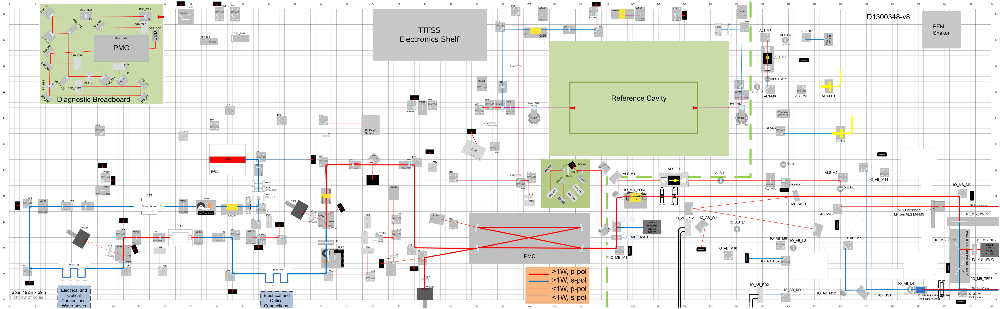

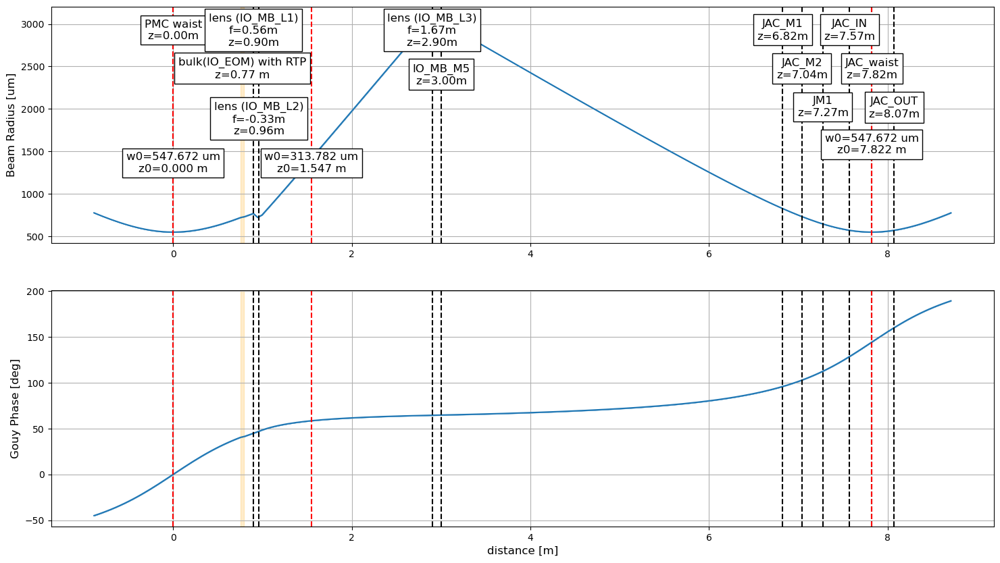

In [7]:
PSL_to_JAC = copy.deepcopy(PSL_to_JAC_for_MM)
IO_MB_Ls = {
    'IO_MB_L1': Lens(name='IO_MB_L1', pos=None, theta=0, f=JAC_mm_solution['IO_MB_L1'].f,quality=quality,bp_plot=True),
    'IO_MB_L2': Lens(name='IO_MB_L2', pos=None, theta=0, f=JAC_mm_solution['IO_MB_L2'].f,quality=quality,bp_plot=True),
    'IO_MB_L3': Lens(name='IO_MB_L3', pos=None, theta=0, f=JAC_mm_solution['IO_MB_L3'].f,quality=quality,bp_plot=True),
}
for optic in IO_MB_Ls:
    PSL_to_JAC.add_component_D(JAC_mm_solution[optic].z, IO_MB_Ls[optic])

for optic in ['JAC', 'JAC_IN', 'JAC_OUT', 'JAC_CM1', 'JAC_CM2']:
    PSL_to_JAC.shift_component(optic,[JAC_delta_z, 0, 0])

for optic in ['IO_MB_M1','PMC out','IO_MB_M2','IO_MB_M3','IO_MB_M4','IO_MB_M6','IO_MB_HWP2']:
    PSL_to_JAC[optic].bp_comp.plot = False

xlim,ylim = PSL_to_JAC['PSL_table'].get_range()
fig,ax = plt.subplots(figsize=((xlim[1]-xlim[0])*20,(ylim[1]-ylim[0])*20))
PSL_to_JAC.draw(ax)
ax.set_xlim(xlim)
ax.set_ylim(ylim)
fig.savefig(f'Figs/{site}/Layout_PSL_{site}.png')
fig.savefig(f'Figs/{site}/Layout_PSL_{site}.pdf')


fig,_,_ = PSL_to_JAC.plot_bp()
fig.savefig(f'Figs/{site}/JAC_MM_BP_{site}.png')
fig.savefig(f'Figs/{site}/JAC_MM_BP_{site}.pdf')
fig.savefig(f'Figs/{site}/JAC_MM_BP_{site}.pdf')

In [8]:
# Google Sheets に貼り付けやすい形式（TSV）で出力
print("name\tz [m]\tbeam radius [um]")
for comp in PSL_to_JAC.bp.get_comp_list()[1:-2]:
    comp_z = comp.z
    beam_size, _ = PSL_to_JAC.bp.beam_size(comp_z)
    print(f"{comp.name}\t{comp_z:.3f}\t{beam_size * 1e6:.0f}")

name	z [m]	beam radius [um]
PMC waist	0.000	548
PMC out	0.254	570
IO_MB_M1	0.432	609
IO_MB_M2	0.678	690
IO_EOM_in	0.753	719
IO_EOM	0.773	723
IO_EOM_out	0.793	727
IO_MB_L1	0.898	768
IO_MB_L2	0.959	708
IO_MB_M3	2.355	2414
IO_MB_HWP2	2.482	2572
IO_MB_M4	2.812	2983
IO_MB_L3	2.900	3093
IO_MB_M5	3.003	3030
IO_MB_M6	3.904	2484
JAC_M1	6.825	825
JAC_M2	7.040	731
JM1	7.274	644
JAC_IN	7.572	569
JAC_waist	7.822	548


# IMC modematch initial condition

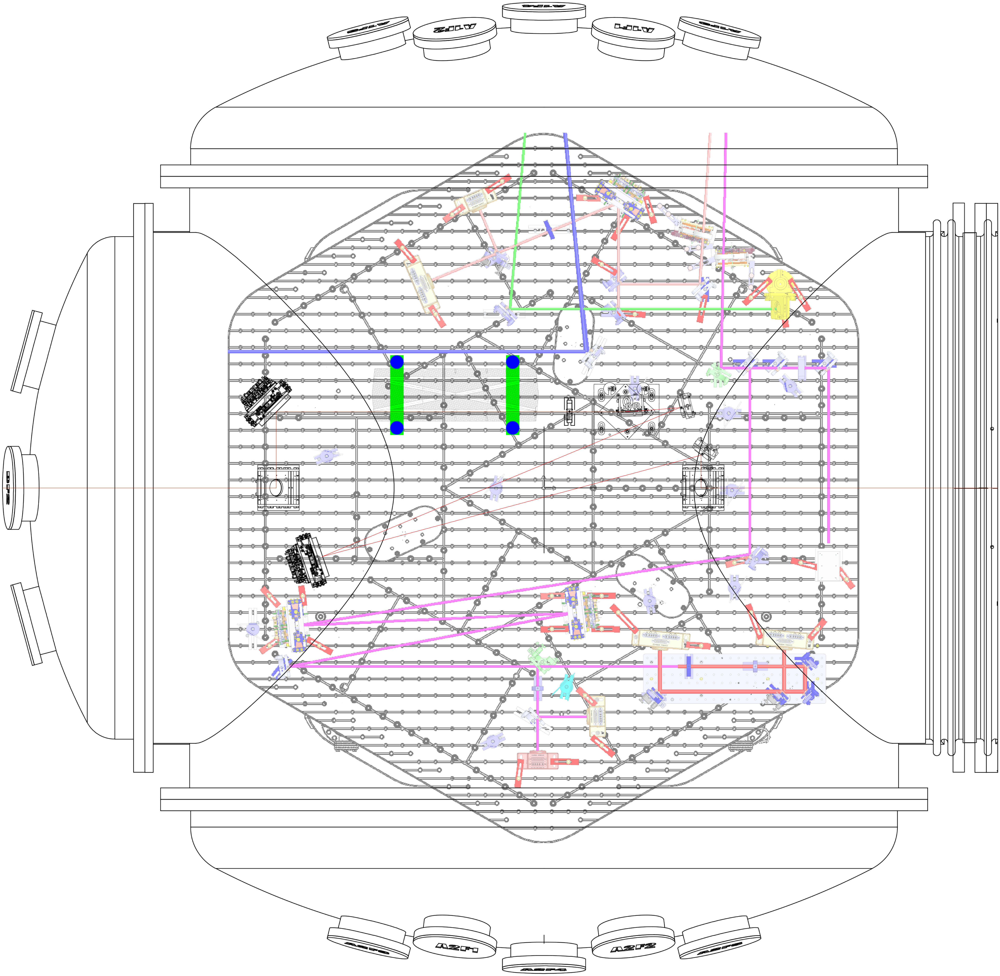

In [9]:
PSL_to_IMC_for_MM = copy.deepcopy(PSL_to_JAC)
PSL_to_IMC_for_MM.set_origin_comp('JAC_OUT')

RoC_L1 = 0.2
L_JACo_EOMi = 0.275 - 4*inch + 4*inch - 0.005
L_JACo_L1 = 0.125 - 3*inch + 2*inch
L_JM2_w0 = 0.1
L_JACM3_JACM4 = 0.1
AOI_JACM3 = 37.5 # 39.5
rad_AOI_JACM3 = np.deg2rad(AOI_JACM3)
L_JM3_JACM3 = 1.2 # 1.5

JAC_L1 = Lens(name='JAC_L1', pos = PSL_to_IMC_for_MM['JAC_OUT'].pos + np.array([L_JACo_L1,0,0]), theta=0, f=RoC2f(RoC_L1), quality=quality, bp_plot=True)
ISC_EOM = ISC_EOM_comp(P=P_PSL*1, name='ISC_EOM', pos=PSL_to_IMC_for_MM['JAC_OUT'].pos + np.array([L_JACo_EOMi,0,0]), beam_ang_deg=0, def_point='in', direction=1, quality=quality)
ISC_EOM_in, ISC_EOM_out = ISC_EOM.get_node()

comp_list = [JAC_L1, ISC_EOM_in, ISC_EOM, ISC_EOM_out]
for comp in comp_list:
    PSL_to_IMC_for_MM.add_component(comp, main_path_idx=-1)

PSL_to_IMC_for_MM.set_z()
JM2_w0,_,JM2_z0,_ = PSL_to_IMC_for_MM.bp.get_output_waist()
L_EOMo_JM2 = JM2_z0 - PSL_to_IMC_for_MM[ISC_EOM_out.name].z - L_JM2_w0
ang_EOMo = np.deg2rad(ISC_EOM.output_angle)
pos_JM2 = PSL_to_IMC_for_MM['ISC_EOM_out'].pos + L_EOMo_JM2*np.array([np.cos(ang_EOMo), np.sin(ang_EOMo), 0])
JM2 = Mirror(name='JM2', pos=pos_JM2)


# periscope
pos_JAC_M5_PSL_cordinate = pos_JAC_M5 + (HAM1.origin_in_global - PSL.origin_in_global)
pos_JAC_M4 = pos_JAC_M5_PSL_cordinate - np.array([0,0,HAM1_periscope_height])
pos_JAC_M3 = pos_JAC_M4 + np.array([0,L_JACM3_JACM4,0])

# JM3 position
rad_AOI_JACM3 = np.deg2rad(AOI_JACM3)
func_pos_JM3 = lambda L_JM3_JACM3: pos_JAC_M3 - L_JM3_JACM3*np.array([np.sin(2*rad_AOI_JACM3), np.cos(2*rad_AOI_JACM3), 0])
pos_JM3 = func_pos_JM3(L_JM3_JACM3)
JM3 = TipTilt(name='JM3', pos=pos_JM3)


JAC_M3 = Mirror(name='JAC_M3', pos=pos_JAC_M3)
JAC_M4 = void(name='JAC_M4',pos=pos_JAC_M4,bp_plot=True)
JAC_M5 = Periscope(name='JAC_M5',pos=pos_JAC_M5_PSL_cordinate, theta=0, quality=quality, bp_plot=True)


comp_list = [JM2, JM3, JAC_M3, JAC_M4, JAC_M5]
for comp in comp_list:
    PSL_to_IMC_for_MM.add_component(comp, main_path_idx=-1)

PSL_to_IMC_for_MM += HAM2

# IMC waist (outside)
L_MC1_MC3 = 232.5e-3*2
L_w0_MC1AR = L_MC1_MC3/2 - norm(pos_MC1_HR[site]-pos_MC1_AR[site])*n_FS
z_w0 = PSL_to_IMC_for_MM['MC1_AR'].z - L_w0_MC1AR
target_IMCw = void(name='IMC waist', pos=None, bp_plot=True)
PSL_to_IMC_for_MM.add_component_D(z_w0, target_IMCw)

xlim,ylim = PSL_to_IMC_for_MM['HAM1_chamber'].get_range()
fig,ax = plt.subplots(figsize=((xlim[1]-xlim[0])*20,(ylim[1]-ylim[0])*20))
PSL_to_IMC_for_MM.draw(ax)
ax.set_xlim(xlim)
ax.set_ylim(ylim)

zz_IMC = np.linspace(-1,6,200)
# _,_,_ = PSL_to_IMC_for_MM.plot_bp(zz=zz_IMC)


# Modematching

Finding mode match solutions: 100%|██████████| 1/1 [00:00<00:00, 581.17it/s]


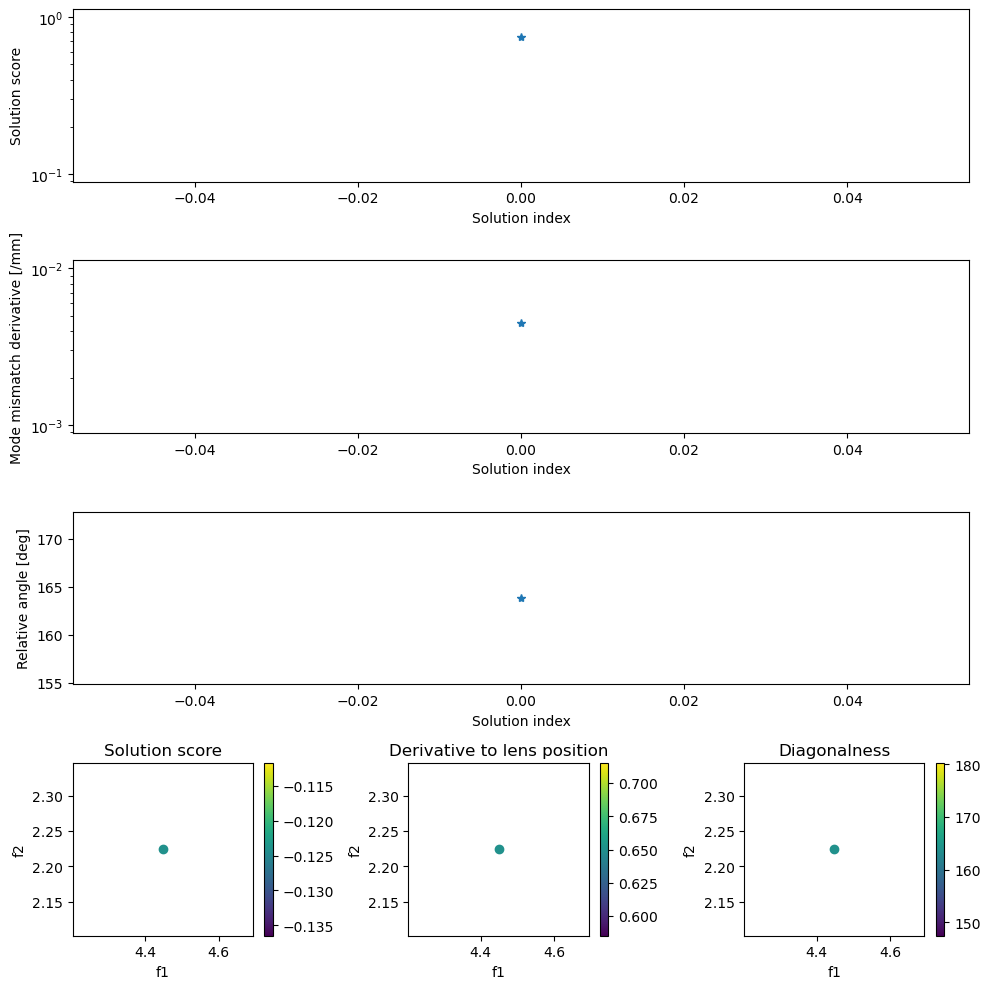

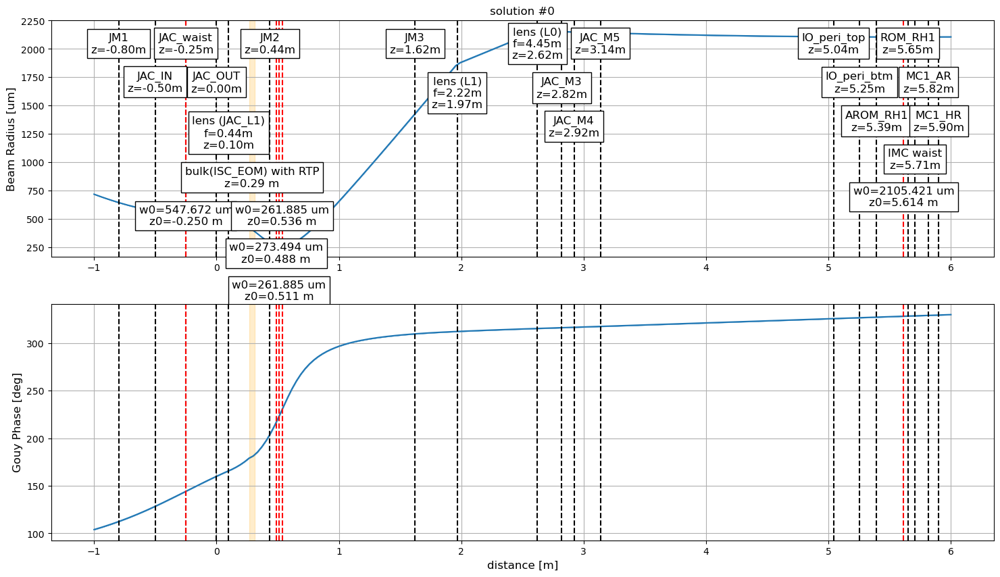

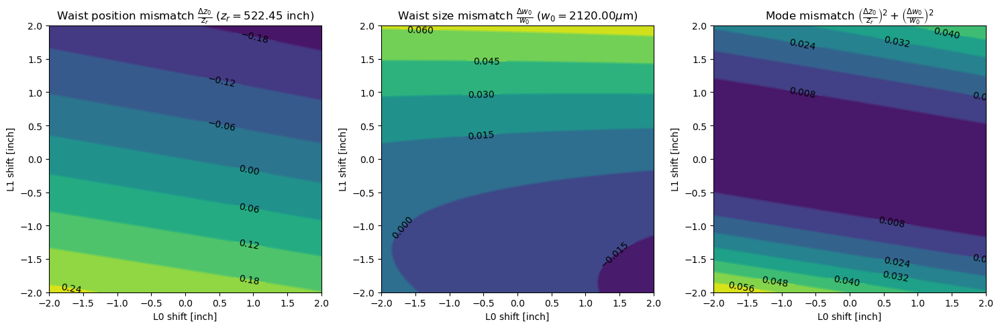

In [10]:
bp_JACout = PSL_to_IMC_for_MM.bp
w_IMC = 2.12e-3
Lens_RoC_IMC = np.array([2,1])
Lend_f_IMC = RoC2f(Lens_RoC_IMC)
zlim_JAC2IMC,grid_n = [[bp_JACout['JM3'].z+0.3,bp_JACout['JAC_M3'].z-0.2]],10
z0_target = [bp_JACout['IMC waist'].z-0.1,bp_JACout['IMC waist'].z+0.1]

mmt_IMC = bp.modematching_tool(Lend_f_IMC,zlim_JAC2IMC,w_IMC,z0_target=z0_target)
IMC_bp_list,IMC_best_mode_mm_list,_ = mmt_IMC.find_modematch_solutions(bp=bp_JACout,grid_n=grid_n,threshold=1e-2, 
                                                                         lensnum_max=2,lensnum_min=2,allow_duplicates=False)

sort_idx_IMC, bp_finesse_plot, IMC_MM_2D_plot = mmt_IMC.show_MM_solutions(zz_IMC,plot_num=5,mode_mm_acceptance=0.01,weight=np.array([1,0]),dz_range=25.4*2e-3)

# HAM1 Layout

In [11]:

def inverse_func_L_JM2_JACM3(pos_JAC_M3, rad_AOI_JACM3, target_L_JM2_JACM3):
    """
    与えられた L_JM2_JACM3 に対する L_JM3_JACM3 を数値的に求める関数
    :param target_L_JM2_JACM3: 既知の L_JM2_JACM3
    :param initial_guess: 初期推定値
    :return: L_JM3_JACM3
    """
    func_pos_JM3 = lambda L_JM3_JACM3: pos_JAC_M3 - L_JM3_JACM3*np.array([np.sin(2*rad_AOI_JACM3), np.cos(2*rad_AOI_JACM3), 0])
    # 根を探す関数を定義
    def func_to_solve(L_JM3_JACM3):
        pos_JM3 = func_pos_JM3(L_JM3_JACM3)
        L = norm(pos_JM3-pos_JM2) + norm(pos_JAC_M3-pos_JM3)
        return L - target_L_JM2_JACM3

    # 数値解を求める（区間を適当に [-10, 10] に設定、必要に応じて調整）
    result = root_scalar(func_to_solve, bracket=[0, 3], method='brentq')

    if result.converged:
        return result.root
    else:
        raise ValueError("解が収束しませんでした。初期値や探索範囲を見直してください。")

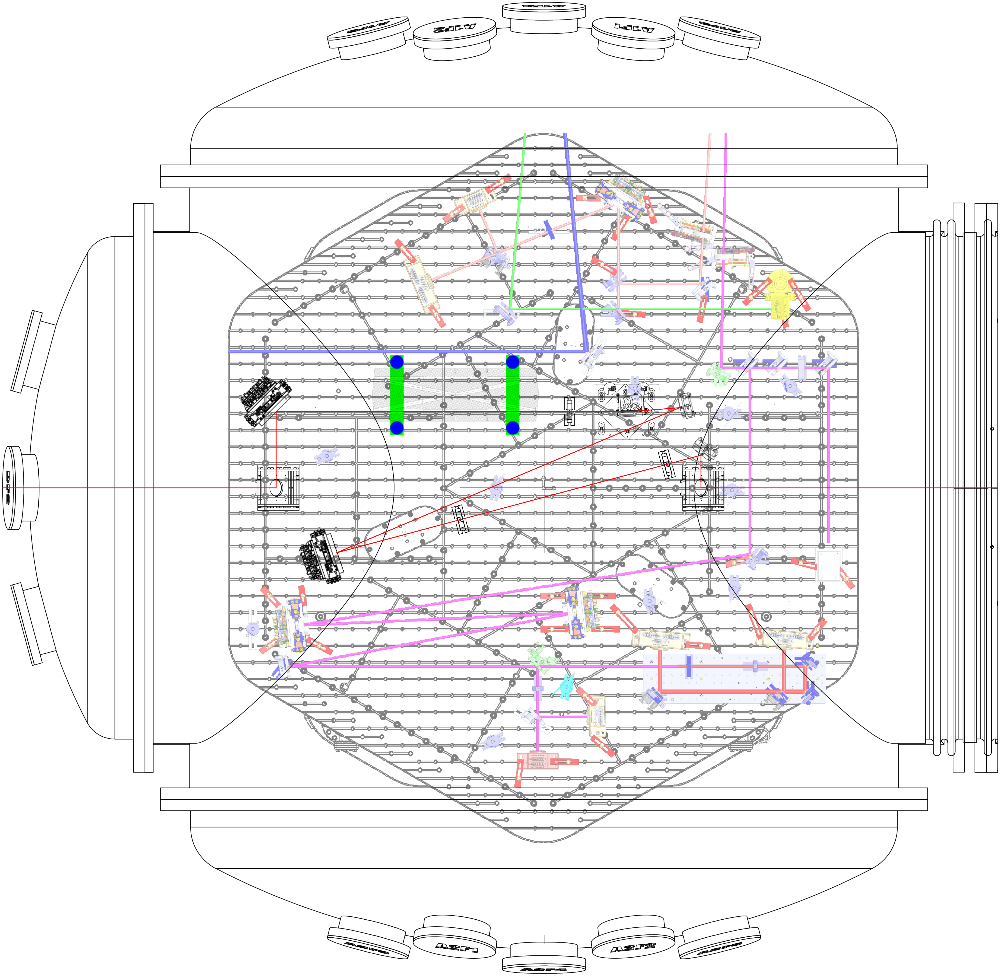

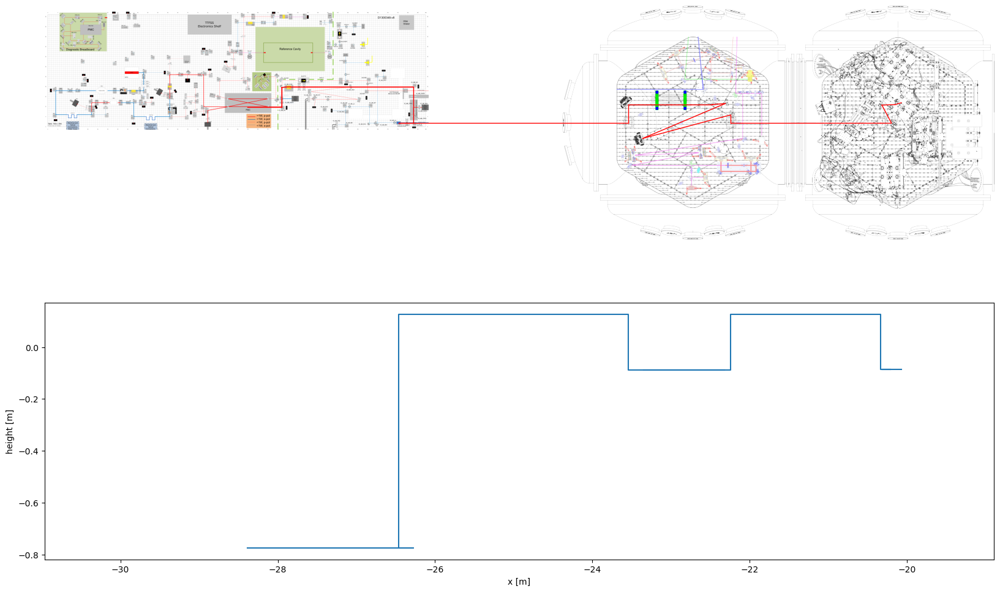

In [12]:
IMC_mm_solution = copy.deepcopy(IMC_bp_list[sort_idx_IMC[0]])
IMC_w, _, IMC_z, _ = IMC_mm_solution.get_output_waist()
IMC_delta_z = IMC_z - IMC_mm_solution['IMC waist'].z

PSL_to_IMC = copy.deepcopy(PSL_to_IMC_for_MM)


L_JM2_JACM3 = (IMC_mm_solution['JAC_M3'].z+IMC_delta_z) - IMC_mm_solution['JM2'].z
L_JM3_JACM3_sol = inverse_func_L_JM2_JACM3(pos_JAC_M3, rad_AOI_JACM3, L_JM2_JACM3)
pos_JM3_sol = func_pos_JM3(L_JM3_JACM3_sol)
PSL_to_IMC.move_component_to('JM3',pos_JM3_sol)


jj = 0
for ii,lensname in enumerate(IMC_mm_solution.get_lens_namelist()):
    if 'IO_MB' in lensname:
        continue
    IMC_mm_solution[lensname].name = 'JAC_L%d'%(jj+1)
    jj += 1
    
JAC_Ls = {
    'JAC_L2': Lens(name='JAC_L2', pos=None, theta=0, f=IMC_mm_solution['JAC_L2'].f, quality=quality, bp_plot=True),
    'JAC_L3': Lens(name='JAC_L3', pos=None, theta=0, f=IMC_mm_solution['JAC_L3'].f, quality=quality, bp_plot=True),
}

for optic in JAC_Ls:
    PSL_to_IMC.add_component_D(IMC_mm_solution[optic].z, JAC_Ls[optic])


xlim,ylim = PSL_to_IMC['HAM1_chamber'].get_range()
# PSL_to_IMC['HAM1_old'].alpha = 0.5
fig,ax = plt.subplots(figsize=((xlim[1]-xlim[0])*20,(ylim[1]-ylim[0])*20))
PSL_to_IMC.draw(ax,linewidth=3)
ax.set_xlim(xlim)
ax.set_ylim(ylim)


fig, axs = plt.subplots(2,1,figsize=(20,12))
PSL_to_IMC.draw(axs[0],'r')
PSL_to_IMC.plot_height(fig, axs[1])
axs[1].set_xlim(axs[0].get_xlim())
fig.savefig('Figs/JAC_height.png')
fig.savefig('Figs/JAC_height.pdf')


L_MC1_MC2 = np.sqrt((-20072+3833.1)**2+(255-487.5)**2)*1e-3
L_MC1_MC3 = (720-255)*1e-3
R_MC2 = 27.24

PSL_to_IMC.bp.add_mirror(PSL_to_IMC.bp['MC1_HR'].z+L_MC1_MC2, name='MC2_HR',plot=True,R=R_MC2)
PSL_to_IMC.bp.add_void(PSL_to_IMC.bp['MC2_HR'].z+L_MC1_MC2, name='MC3_HR',plot=True)

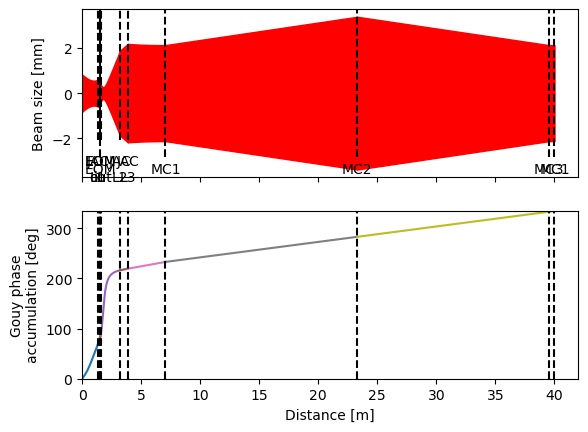

In [13]:
import finesse
finesse.configure(plotting=False)

bp_finesse = copy.deepcopy(PSL_to_IMC.bp)
L0_L1 = bp_finesse['JAC_L1'].z+0.25+1
L1_EOMin = bp_finesse['ISC_EOM_in'].z-bp_finesse['JAC_L1'].z
EOMin_EOM = bp_finesse['ISC_EOM'].z - bp_finesse['ISC_EOM_in'].z
EOM_EOMout = bp_finesse['ISC_EOM_out'].z - bp_finesse['ISC_EOM'].z
EOMout_L2 = bp_finesse['JAC_L2'].z-bp_finesse['ISC_EOM_out'].z
L2_L3 = bp_finesse['JAC_L3'].z-bp_finesse['JAC_L2'].z
L3_MC1_HR = bp_finesse['MC1_HR'].z - bp_finesse['JAC_L3'].z

f_L1 = bp_finesse['JAC_L1'].f
f_L2 = bp_finesse['JAC_L2'].f
f_L3 = bp_finesse['JAC_L3'].f
D = -bp_finesse['ISC_EOM'].thermal_lens(bp_finesse.beam_size(bp_finesse['ISC_EOM'].z)[0],P=100)[1,0]
f_EOM = 1/D
n_EOM = bp_finesse['ISC_EOM'].n


model = finesse.Model()
model.parse(f"""
lambda(1064n)

# Laser
l L0 P=1

# Gaussian beam definition — note: port is L0.p1, not just L0
# gauss G1 L0.p1.o 1064n w0=0.547672e-3 z=-1  
            
# Space before lens
s sL0L1 L0.p1 JAC_L1.p1 L={L0_L1}
s sL1EOMi JAC_L1.p2 EOM_in.p1 L={L1_EOMin}
s sEOMiEOM EOM_in.p2 EOM.p1 L={EOMin_EOM} nr={n_EOM}
s sEOMEOMo EOM.p2 EOM_out.p1 L={EOM_EOMout} nr={n_EOM}
s sEOMoL2 EOM_out.p2 JAC_L2.p1 L={EOMout_L2}
s sL2L3 JAC_L2.p2 JAC_L3.p1 L={L2_L3}

# Thin lens
lens EOM {f_EOM}
lens JAC_L1 {f_L1}  
lens JAC_L2 {f_L2} 
lens JAC_L3 {f_L3}

# Space after lens
s sL3MC1 JAC_L3.p2 MC1.p1 L={L3_MC1_HR}
s sMC1MC2 MC1.p3 MC2.p1 L={L_MC1_MC2}
s sMC2MC3 MC2.p2 MC3.p1 L={L_MC1_MC2}
s sMC3MC1 MC3.p2 MC1.p4 L={L_MC1_MC3}

# Dummy mirror to terminate the beam path
m EOM_in 1 0
m EOM_out 1 0
bs MC1 0.99 0.01
bs MC2 1 0 Rc={R_MC2}
bs MC3 0.99 0.01


cav IMC MC1.p3
""")


# ビーム伝搬パス：レーザーから dummy mirror M1 まで
path = model.path(model.L0.p1, model.MC1.p4)

# プロパゲーション計算
ps = model.propagate_beam(path=path)
data = ps.all_segments('beamsize','gouy',add_gouy=True,w_scale=1,npts=2000,resolution='equal')
zz_finesse,bs_finesse,gouy_finesse = [],[],[]

for zs, segd in data.values():
    zz_finesse = np.concatenate([zz_finesse,zs])
    bs_finesse = np.concatenate([bs_finesse,segd['beamsize']])
    gouy_finesse = np.concatenate([gouy_finesse,segd['gouy']])


# プロット
fig,axs = ps.plot(
    name_xoffsets={"LENS": 15},
)


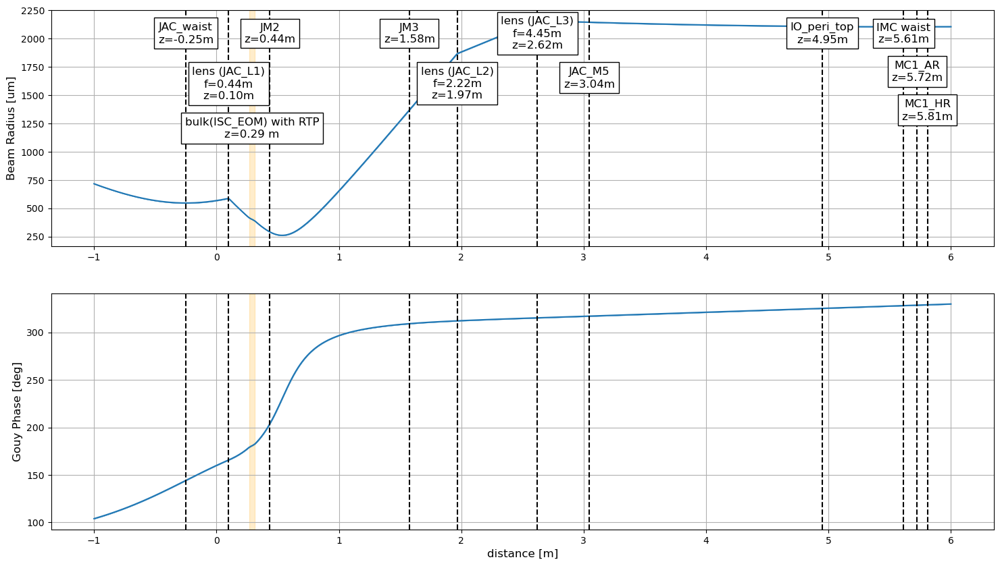

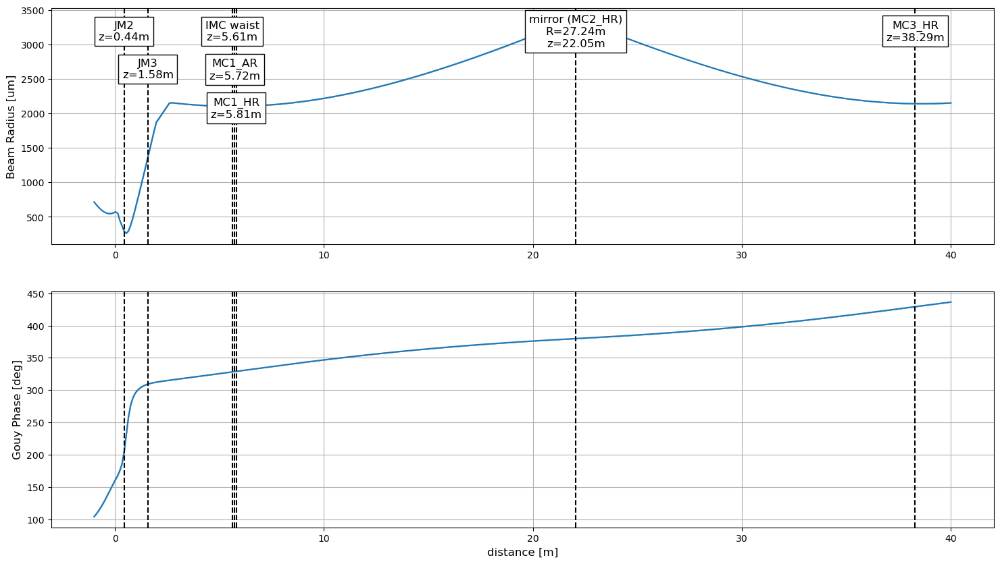

In [23]:
all_optics = []
IMC_mm_bp = copy.deepcopy(PSL_to_IMC.bp)

for optic in IMC_mm_bp.get_comp_list():
    if (not 'MC' in optic.name) and (not 'JM3' in optic.name) and (not 'JM2' in optic.name):
        all_optics.append(optic.name)
zoomin_optics = ['JM1','JAC_IN','JAC_OUT','JAC_M3','JAC_M4','IO_peri_btm','AROM_RH1','ROM_RH1',]

# lensname = IMC_mm_bp.get_lens_namelist()
# lenscomb = [(lensname[3],lensname[4]),(lensname[3],lensname[5]),(lensname[4],lensname[5])]
# for lenses in lenscomb:
#     fig2,_,_,_,_ = IMC_mm_solution.plot_MM_2D(lenses)
#     fig2.savefig(f'Figs/{site}/IMC_modematching_layout_2d_{lenses[0]}_{lenses[1]}.png')
#     fig2.savefig(f'Figs/{site}/IMC_modematching_layout_2d_{lenses[0]}_{lenses[1]}.pdf')

zz_IMC_MM1= np.linspace(-1,6,400)
zz_IMC_MM2= np.linspace(-1,40,400)

for xlim, ylim_bs, ylim_gouy, optics, zz_IMC_MM, postfix in zip([(-1.25,6),(-1.25,40)],[(0,2300),(0,3500)],[(-120,120),(-120,240)],[zoomin_optics,all_optics],[zz_IMC_MM1,zz_IMC_MM2],['','_ZoomOut']):
    IMC_mm_bp = copy.deepcopy(PSL_to_IMC.bp)
    for optic in optics:
        IMC_mm_bp[optic].plot = False

    fig,ax,_ = IMC_mm_bp.plot(zz=zz_IMC_MM,verbose=['component'],)
    fig.savefig(f'Figs/{site}/IMC_MM_BP_{site}{postfix}.png')
    fig.savefig(f'Figs/{site}/IMC_MM_BP_{site}{postfix}.pdf')

# Beam size and AOI

In [15]:
# Google Sheets に貼り付けやすい形式（TSV）で出力
print("name\tz [m]\tbeam radius [um]")
for comp in IMC_mm_bp.get_comp_list()[1:-2]:
    comp_z = comp.z
    beam_size, _ = PSL_to_JAC.bp.beam_size(comp_z)
    print(f"{comp.name}\t{comp_z:.3f}\t{beam_size * 1e6:.0f}")

name	z [m]	beam radius [um]
PMC waist	-8.072	5022
PMC out	-7.818	4866
IO_MB_M1	-7.640	4756
IO_MB_M2	-7.394	4605
IO_EOM_in	-7.319	4559
IO_EOM	-7.299	4547
IO_EOM_out	-7.279	4535
IO_MB_L1	-7.174	4470
IO_MB_L2	-7.113	4433
IO_MB_M3	-5.717	3578
IO_MB_HWP2	-5.590	3500
IO_MB_M4	-5.260	3299
IO_MB_L3	-5.172	3245
IO_MB_M5	-5.069	3182
IO_MB_M6	-4.168	2635
JAC_M1	-1.247	946
JAC_M2	-1.032	841
JM1	-0.798	737
JAC_IN	-0.500	629
JAC_waist	-0.250	569
JAC_OUT	0.000	548
JAC_L1	0.100	551
ISC_EOM_in	0.270	573
ISC_EOM	0.290	576
ISC_EOM_out	0.310	580
JM2	0.436	611
JM3	1.576	1451
JAC_L2	1.967	1933
JAC_L3	2.621	2746
JAC_M3	2.730	2881
JAC_M4	2.830	3005
JAC_M5	3.045	3005
IO_peri_top	4.949	1859
IO_peri_btm	5.161	1734
AROM_RH1	5.301	1652
ROM_RH1	5.557	1504
IMC waist	5.614	1471
MC1_AR	5.724	1408
MC1_HR	5.809	1360
MC2_HR	22.049	8815


In [16]:
print(f"AOI of JM2: {angle_abc(PSL_to_IMC['ISC_EOM_out'].pos,PSL_to_IMC['JM2'].pos,PSL_to_IMC['JM3'].pos)/2:.2f} deg")
print(f"AOI of JM3: {angle_abc(PSL_to_IMC['JM2'].pos,PSL_to_IMC['JM3'].pos,PSL_to_IMC['JAC_L2'].pos)/2:.2f} deg")


AOI of JM2: 9.17 deg
AOI of JM3: 3.97 deg


# JAC REFL path design (LHO)

In [17]:
class ISCT1_group(group):
    def __init__(self, site, quality):
        self.site = site
        self.quality = quality

        # vieport position
        pos_HAM1_vp_center = np.array([HAM1_loc_dict[site][0],HAM1_loc_dict[site][1]+1.5,-0.1])

        # background
        ISCT1_table = component(name='ISCT1_table',pos=[0,0,0], theta=180, image_path=f'Figs/ForPlot/ISCT1_{quality}.png', pos_center=[1.350,80e-3], dpi=dpi_dict[quality])
        Periscope = component(name='ISCT1_Periscope', pos=[-0.75,0.2,0], theta=0, image_path=f'Figs/ForPlot/ISCT1_peri_{quality}.png', pos_center=None, dpi=dpi_dict[quality])

        component_list = []
        main_path = component_list
        super().__init__(origin_in_global=pos_HAM1_vp_center+np.array([0,26*inch-0.1,0]), background_list=[ISCT1_table,Periscope], component_list = component_list, origin_comp=None, w0=small_waist[0], z0=0, main_connection=main_path)

    def pos_converter(self, pos_inch_x, pos_inch_y, height=4*inch):
        pos = (np.array([pos_inch_x, pos_inch_y, 0]) + np.array([1.5,1.5,height/inch]))*inch
        return pos
    
class IOT1_group(group):
    def __init__(self, site, quality):
        self.site = site
        self.quality = quality

        # vieport position
        pos_HAM1_vp_center_lower = np.array([HAM1_loc_dict[site][0],HAM1_loc_dict[site][1]-1.5,-0.1])

        # background
        ISCT1_table = component(name='IOT1_table',pos=[0,0,0], theta=0, image_path=f'Figs/ForPlot/IOT1_{quality}.png', pos_center=[1.350,80e-3], dpi=dpi_dict[quality])
        Periscope = component(name='IOT1_Periscope', pos=[-25*inch,-4*inch,0], theta=0, image_path=f'Figs/ForPlot/ISCT1_peri_{quality}.png', pos_center=None, dpi=dpi_dict[quality])

        component_list = []
        main_path = component_list
        super().__init__(origin_in_global=pos_HAM1_vp_center_lower+np.array([15*inch - 4*inch,-28*inch+0.1,0]), background_list=[ISCT1_table,Periscope], component_list = component_list, origin_comp=None, w0=small_waist[0], z0=0, main_connection=main_path)

    def pos_converter(self, pos_inch_x, pos_inch_y, height=4*inch):
        pos = (np.array([pos_inch_x, pos_inch_y, 0]) + np.array([1.5,1.5,height/inch]))*inch
        return pos
    


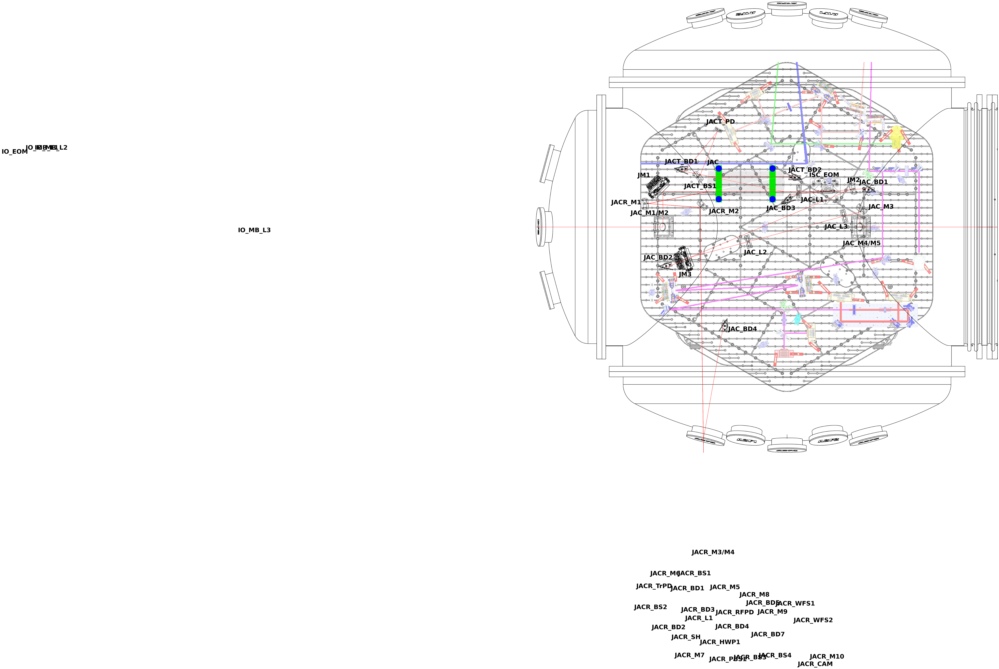

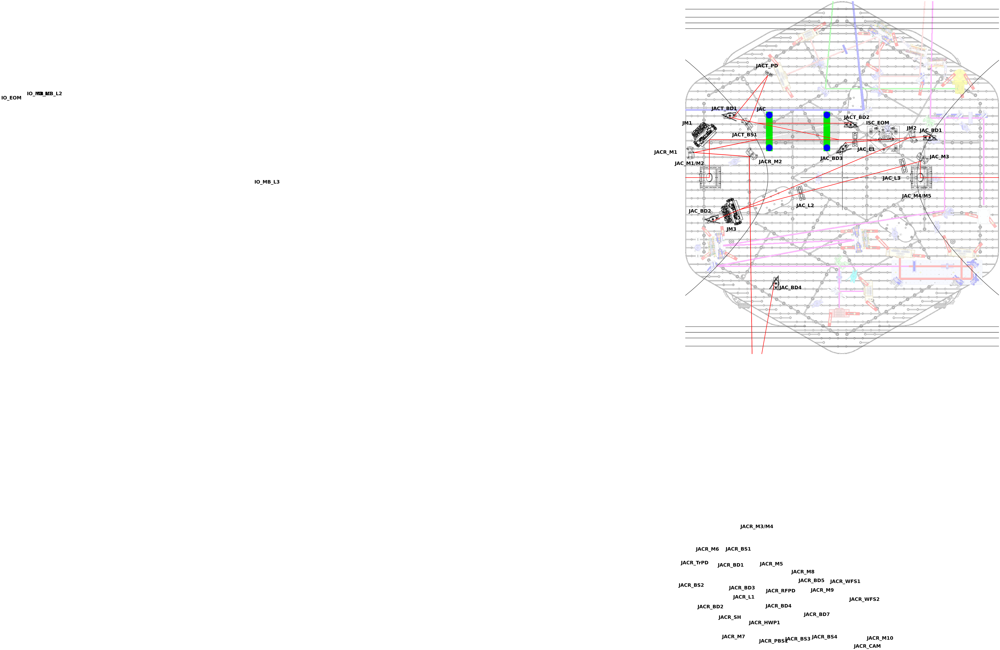

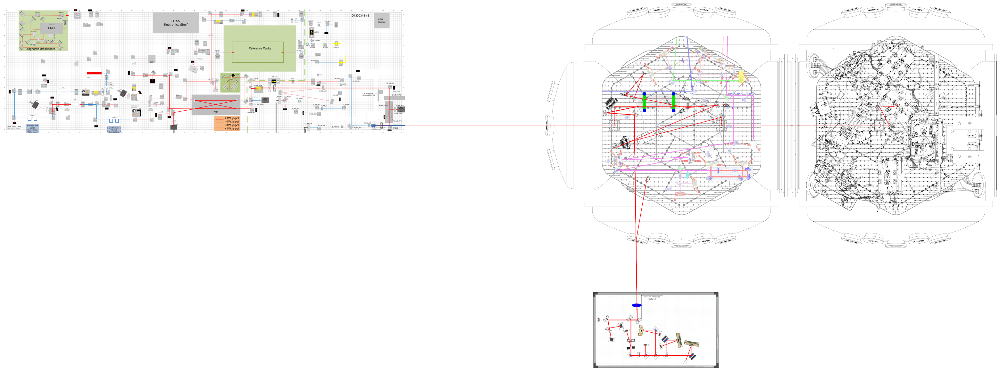

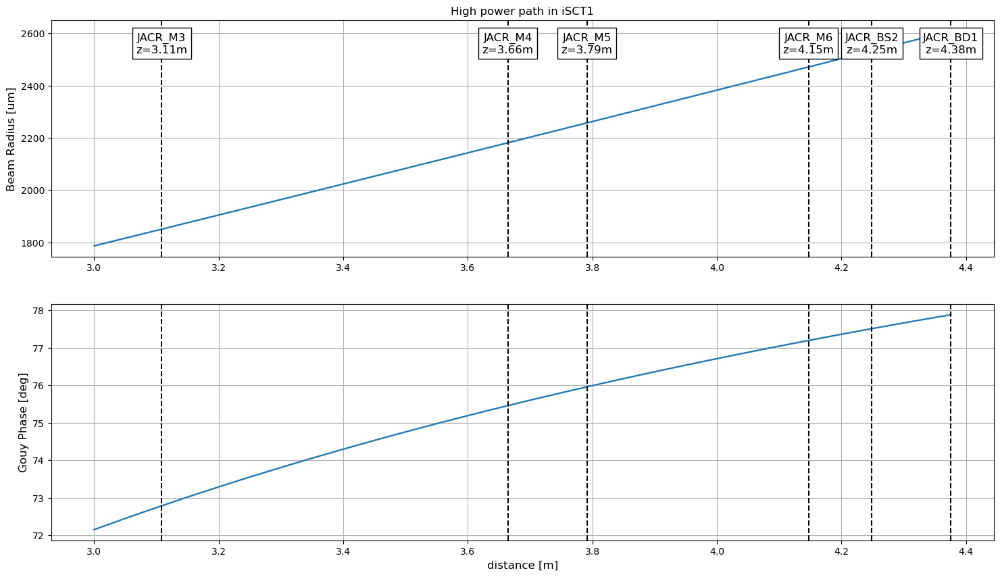

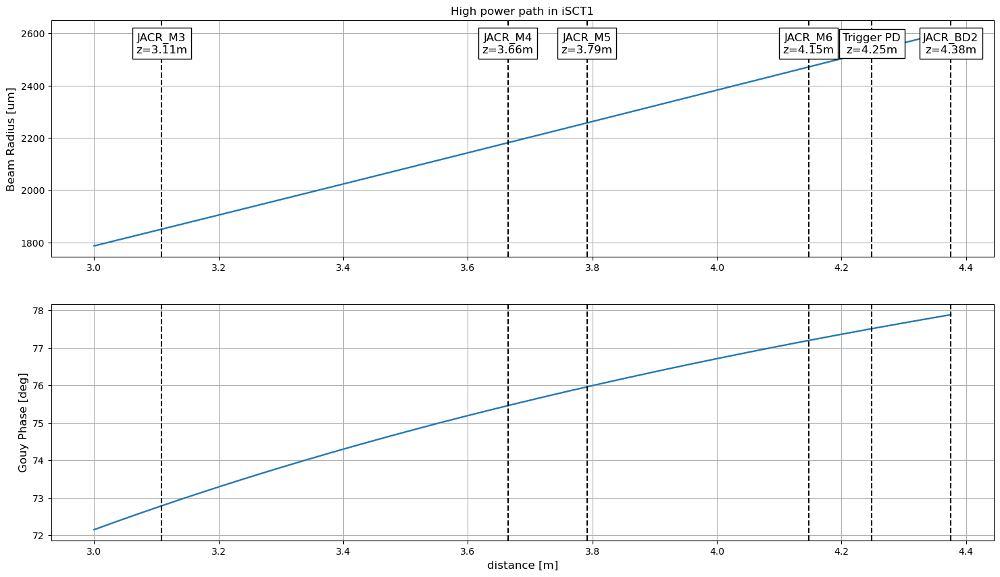

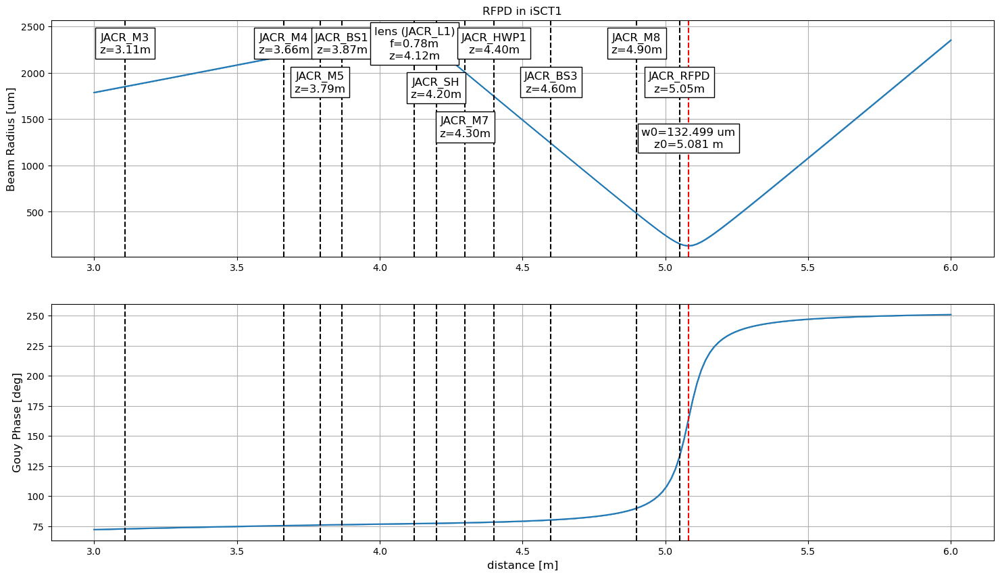

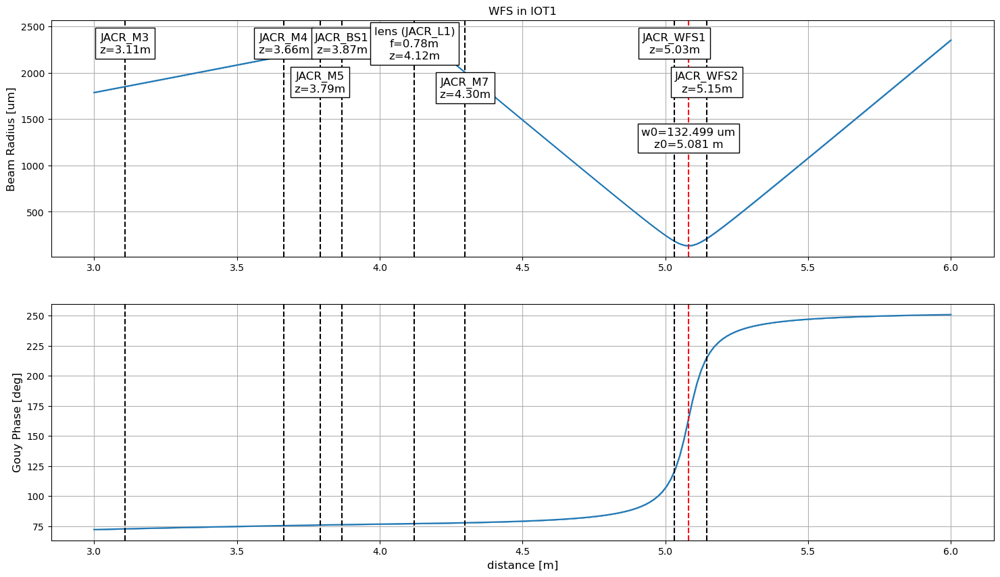

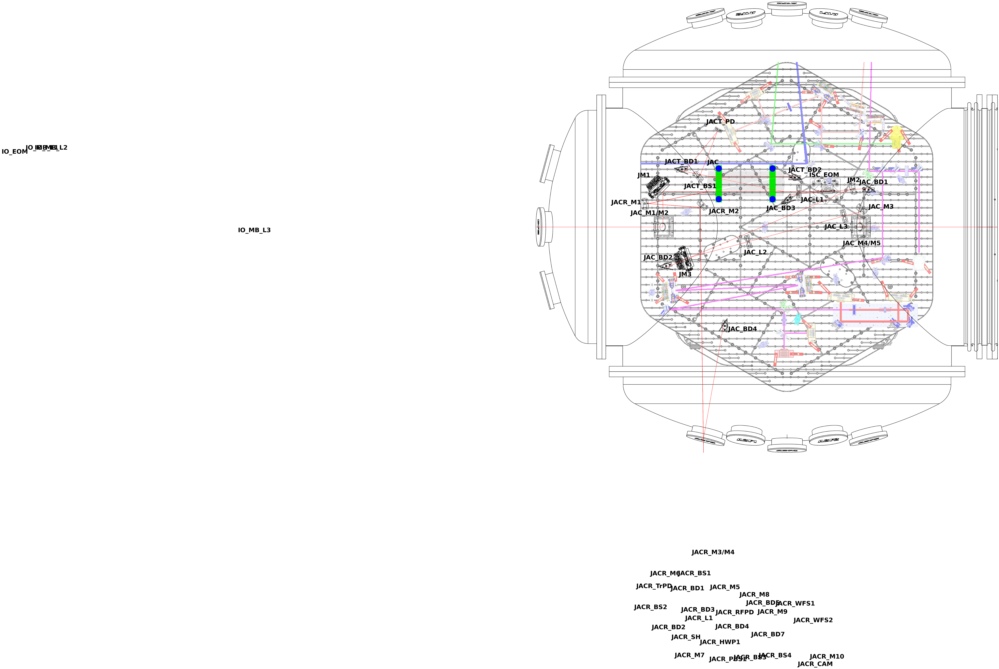

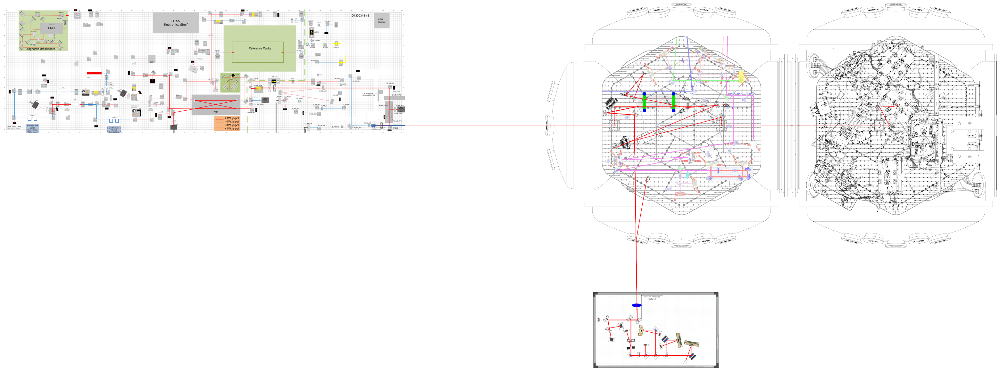

In [18]:

IOT1 = IOT1_group(site,quality)
JAC_REFL = copy.deepcopy(PSL_to_IMC)
JAC_REFL += IOT1
for ii in range(len(JAC_REFL.main_connection)-1):
    comp = JAC_REFL.main_connection[ii]
    next_comp = JAC_REFL.main_connection[ii+1]
    JAC_REFL.add_connection([comp, next_comp])

JAC_REFL.main_connection = [str(JAC_REFL['JAC_IN'])]
JAC_REFL.set_origin_comp('JAC_IN')
JAC_REFL.set_waist(w0=JAC_w0, z0=0.25)

# invac PD and BD
theta_JAC = angle_abc(PSL_to_IMC['JAC_IN'].pos,PSL_to_IMC['JAC_OUT'].pos,PSL_to_IMC['JAC_CM1'].pos)
L_JACCM1_JACBS1 = 2*inch
L_JACBS1_JACBD1 = 5*inch
L_JACBS1_JACTPD = 12*inch
L_JACCM2_JACTBD2 = 3*inch
L_JM2_JACBD1 = 5*inch
L_JM3_JACBD2 = 7*inch

pos_JACTBS1 = extend_point(L_JACCM1_JACBS1,PSL_to_IMC['JAC_OUT'].pos,PSL_to_IMC['JAC_CM1'].pos)
JACT_BS1 = Mirror('JACT_BS1',pos_JACTBS1,theta=45-theta_JAC/2,quality=quality)

pos_JACTBD1 = extend_point(L_JACBS1_JACBD1,PSL_to_IMC['JAC_OUT'].pos,pos_JACTBS1)
JACT_BD1 = Invac_BD('JACT_BD1',pos_JACTBD1,theta=100,quality=quality)


pos_JACTBD1_2 = pos_JACTBD1 + np.array([0.025,0,0])
pos_JACTPD = pos_JACTBS1 + L_JACBS1_JACTPD*np.array([np.sin(np.deg2rad(theta_JAC+10)),np.cos(np.deg2rad(theta_JAC+10)),0])
theta_TPD = (np.arctan2(*(pos_JACTPD[:2]-pos_JACTBD1_2[:2]))+np.arctan2(*(pos_JACTPD[:2]-pos_JACTBS1[:2])))
JACT_PD = PDA100('JACT_PD',pos=pos_JACTPD,theta=np.rad2deg(theta_TPD))
JACT_BD1_2 = void('JAC_BD1_2',pos_JACTBD1_2,bp_plot=False)

pos_JACTBD2 = PSL_to_IMC['JAC_CM2'].pos + np.array([L_JACCM2_JACTBD2,0,0])
JACT_BD2 = Invac_BD('JACT_BD2',pos_JACTBD2,theta=-90,quality=quality)

pos_JACBD1 = extend_point(L_JM2_JACBD1,PSL_to_IMC['ISC_EOM'].pos,PSL_to_IMC['JM2'].pos)
JAC_BD1 = Invac_BD('JAC_BD1',pos_JACBD1,theta=-90,quality=quality)

pos_JACBD2 = extend_point(L_JM3_JACBD2,PSL_to_IMC['JM2'].pos,PSL_to_IMC['JM3'].pos)
JAC_BD2 = Invac_BD('JAC_BD2',pos_JACBD2,theta=110,quality=quality)


JAC_REFL.add_connection([JAC_REFL['JAC_OUT'],JACT_BS1])
JAC_REFL.add_connection([JACT_BS1,JACT_BD1])
JAC_REFL.add_connection([JACT_BS1,JACT_PD])
JAC_REFL.add_connection([JACT_PD,JACT_BD1_2])
JAC_REFL.add_connection([JAC_REFL['JAC_CM1'],JACT_BD2])
JAC_REFL.add_connection([JAC_REFL['JM2'],JAC_BD1])
JAC_REFL.add_connection([JAC_REFL['JM3'],JAC_BD2])



################################
# EOM reflection
theta_refl = JAC_REFL['ISC_EOM'].theta+2.8
L_JAC_L1_ISCEOM = np.linalg.norm(JAC_REFL['ISC_EOM_in'].pos - JAC_REFL['JAC_L1'].pos)
y_EOMR_L1 = L_JAC_L1_ISCEOM*np.tan(np.deg2rad(theta_refl))
pos_EOMR_L1 = JAC_REFL['ISC_EOM_in'].pos - np.array([L_JAC_L1_ISCEOM,y_EOMR_L1,0])
EOMR_L1 = void('EOMR_L1',pos_EOMR_L1,bp_plot=False)

theta_EOMR_L1 = np.deg2rad(theta_refl - y_EOMR_L1/JAC_REFL['JAC_L1'].bp_comp.f)
L_JACL1_JACBD3 = 2.5*inch
pos_JAC_BD3 = pos_EOMR_L1 + L_JACL1_JACBD3*np.array([-np.cos(theta_EOMR_L1),-np.sin(theta_EOMR_L1),0])
JAC_BD3_beam = void('JAC_BD3_beam',pos_JAC_BD3)

BD3_ofs = np.array([-0.25*inch,-1.8*inch,0])
JAC_BD3 = Invac_BD('JAC_BD3',pos_JAC_BD3+BD3_ofs,theta=140,quality=quality)

JAC_REFL.add_connection([JAC_REFL['ISC_EOM_in'],EOMR_L1])
JAC_REFL.add_connection([EOMR_L1,JAC_BD3_beam])
JAC_REFL.add_component(JAC_BD3)

################################
# BD1 path
L_JACi_JACM6 = 0.4
L_vp_JACRM3 = 33*inch
H_ISCT1_peri = 556e-3
L_JACRM4_JACRM5 = 5*inch
L_JACRM5_JACRM6 = 14*inch
L_JACRM6_JACRBS2 = 4*inch
L_JACRBS2_JACRBD1 = 5*inch

pos_JACR_M1 = extend_point(L_JACi_JACM6, JAC_REFL['JAC_CM2'].pos,JAC_REFL['JAC_IN'].pos)
JACR_M1 = Mirror(name='JACR_M1', pos=pos_JACR_M1, bp_plot=True)

pos_JACR_M2 = pos_JACR_M1+np.array([0.34,-0.025,0])
JACR_M2 = Mirror(name='JACR_M2', pos=pos_JACR_M2, bp_plot=True)

pos_HAM1_vp_low = np.array([-0.55,-1.4,0]) + HAM1.origin_in_global - PSL.origin_in_global
pos_HAM1_vp_low[2] = -0.1 - JAC_REFL.origin_in_global[2]
pos_HAM1_vp_low_ofs = np.array([0,0,0])
pos_HAM1_vp_low += pos_HAM1_vp_low_ofs
HAM1_vp_low = void(name='HAM1_vp', pos=pos_HAM1_vp_low, bp_plot=True)

theta_Rvp = np.deg2rad(10)
pos_JAC_BD4 = pos_HAM1_vp_low + 30*inch*np.array([np.sin(theta_Rvp),np.cos(theta_Rvp),0])
JAC_BD4 = Invac_BD('JAC_BD4',pos_JAC_BD4,theta=0,quality=quality)

pos_JACR_M3 = extend_point(L_vp_JACRM3, pos_JACR_M2, pos_HAM1_vp_low)
JACR_M3 = Periscope_InAir(name='JACR_M3', theta=0, pos=pos_JACR_M3, bp_plot=True)

pos_JACR_M4 = pos_JACR_M3 - np.array([0,0,H_ISCT1_peri])
JACR_M4 = void(name='JACR_M4', pos=pos_JACR_M4, bp_plot=True)

pos_JACR_M5 = extend_point(L_JACRM4_JACRM5, pos_HAM1_vp_low, pos_JACR_M3)
pos_JACR_M5[2] = pos_JACR_M4[2]
JACR_M5 = Mirror(name='JACR_M5', pos=pos_JACR_M5, bp_plot=True)

pos_JACR_M6 = pos_JACR_M5 + L_JACRM5_JACRM6*np.array([-1,0,0])
JACR_M6 = Mirror(name='JACR_M6', pos=pos_JACR_M6, bp_plot=True)

theta_M6 = np.deg2rad(40)*2
pos_JACR_BS2 = pos_JACR_M6 + L_JACRM6_JACRBS2*np.array([np.cos(theta_M6),-np.sin(theta_M6),0])
JACR_BS2 = Mirror(name='JACR_BS2', pos=pos_JACR_BS2, bp_plot=True)

pos_JACR_BD1 = pos_JACR_BS2 + L_JACRBS2_JACRBD1*np.array([np.sin(theta_M6),np.cos(theta_M6),0])
JACR_BD1 = HPBD(name='JACR_BD1', pos=pos_JACR_BD1, bp_plot=True, theta=-np.rad2deg(theta_M6)-90)

HP_path_component_list =  [JACR_M1, JACR_M2, HAM1_vp_low, JACR_M3, JACR_M4, JACR_M5, JACR_M6, JACR_BS2, JACR_BD1]
for comp in HP_path_component_list:
    JAC_REFL.add_component(comp, main_path_idx=-1)

JAC_REFL.set_z()
fig, axs, _ = JAC_REFL.plot_bp(zz=np.linspace(3,JAC_REFL.bp['JACR_BD1'].z,200), title='High power path in iSCT1')
fig.savefig(f'Figs/{site}/MM_IOT1_HPBD1.png')
fig.savefig(f'Figs/{site}/MM_IOT1_HPBD1.pdf')

JAC_REFL.add_connection([HAM1_vp_low,JAC_BD4])

################################
# BD2 path
L_JACRBS2_JACRBD2 = L_JACRBS2_JACRBD1
L_JACRM6_JACRTRPD = 4*inch

pos_JACR_BD2 = extend_point(L_JACRBS2_JACRBD2, pos_JACR_M6, pos_JACR_BS2)
JACR_BD2 = HPBD(name='JACR_BD2', pos=pos_JACR_BD2, bp_plot=True, theta=-np.rad2deg(theta_M6)-180)

pos_JACR_TRPD = extend_point(L_JACRM6_JACRTRPD, pos_JACR_M5, pos_JACR_M6)
JACR_TRPD = PDA100(name='JACR_TrPD', pos=pos_JACR_TRPD, bp_plot=True, theta=-180)

JAC_REFL.sub_connection_list.append(JAC_REFL.main_connection)
JAC_REFL.main_connection = ['JAC_IN','JACR_M1', 'JACR_M2', 'HAM1_vp', 'JACR_M3', 'JACR_M4', 'JACR_M5', 'JACR_M6']
BD2_path_component_list =  [JACR_BD2]
for comp in BD2_path_component_list:
    JAC_REFL.add_component(comp, main_path_idx=-1)

JAC_REFL.add_connection([JACR_M5,JACR_TRPD])
# JAC_REFL.add_connection([JACR_BS3,JACR_BD3])

JAC_REFL.set_z()
JAC_REFL.bp.add_void(z=JAC_REFL.bp['JACR_M6'].z+L_JACRM6_JACRTRPD,name='Trigger PD')
fig, axs, _ = JAC_REFL.plot_bp(zz=np.linspace(3,JAC_REFL.bp['JACR_BD2'].z,200), title='High power path in iSCT1')
fig.savefig(f'Figs/{site}/MM_IOT1_TRPD.png')
fig.savefig(f'Figs/{site}/MM_IOT1_TRPD.pdf')


################################
# RFPD path
L_JACRM5_JACRBS1 = 3*inch
L_JACRBS1_JACRL1 = 10*inch
L_JACRBS1_JACRSH = 13*inch
L_JACRSH_JACRBD3 = 8*inch
L_JACRBS1_JACRM7 = 17*inch
L_JACRM7_JACRHWP1 = 4*inch
L_JACRHWP1_JACRPBS1 = 3*inch
L_JACRPBS1_JACRBD4 = 5*inch
L_JACRM7_JACRBS3 = 0.3
L_JACRBS3_JACRM8 = 0.3
L_JACRM8_JACRRFPD = 0.15
L_JACRRFPD_JACRBD5 = 8*inch

pos_JACR_BS1 = pos_JACR_M5 + np.array([-L_JACRM5_JACRBS1,0,0])
JACR_BS1 = Mirror(name='JACR_BS1', pos=pos_JACR_BS1, bp_plot=True)

pos_JACR_L1 = pos_JACR_BS1 + np.array([0,-L_JACRBS1_JACRL1,0])
JACR_L1 =  Lens(name='JACR_L1', pos=pos_JACR_L1, bp_plot=True, theta=0, f=RoC2f(0.35))

Th_JACRSH = np.deg2rad(15+360) # degree
pos_JACR_SH = pos_JACR_BS1 + np.array([0,-L_JACRBS1_JACRSH,0])
JACR_SH = Shutter(name='JACR_SH', pos=pos_JACR_SH, bp_plot=True, theta=np.rad2deg(Th_JACRSH)/2-90)

pos_JACR_BD3 = pos_JACR_SH + L_JACRSH_JACRBD3*np.array([-np.sin(Th_JACRSH),np.cos(Th_JACRSH),0])
JACR_BD3 = LPBD(name='JACR_BD3', pos=pos_JACR_BD3, bp_plot=True, theta=np.rad2deg(Th_JACRSH)+90)

pos_JACR_M7 = pos_JACR_BS1 + np.array([0,-L_JACRBS1_JACRM7,0])
JACR_M7 = Mirror_1in(name='JACR_M7', pos=pos_JACR_M7, bp_plot=True)

Th_JACRHWP1 = np.deg2rad(0) # degree
pos_JACR_HWP1 = pos_JACR_M7 + np.array([L_JACRM7_JACRHWP1,0,0])
JACR_HWP1 = HWP(name='JACR_HWP1', pos=pos_JACR_HWP1, bp_plot=True, theta_ofs = np.rad2deg(Th_JACRHWP1))

pos_JACR_PBS1 = pos_JACR_HWP1 + np.array([L_JACRHWP1_JACRPBS1,0,0])
JACR_PBS1 = Mirror_1in(name='JACR_PBS1', pos=pos_JACR_PBS1, bp_plot=True, theta=135)

pos_JACR_BD4 = pos_JACR_PBS1 + np.array([0,L_JACRPBS1_JACRBD4,0])
JACR_BD4 = LPBD(name='JACR_BD4', pos=pos_JACR_BD4, bp_plot=True, theta=90)

pos_JACR_BS3 = pos_JACR_M7 + np.array([L_JACRM7_JACRBS3,0,0])
JACR_BS3 = Mirror_1in(name='JACR_BS3', pos=pos_JACR_BS3, bp_plot=True)

pos_JACR_M8 = pos_JACR_BS3 + np.array([0,L_JACRBS3_JACRM8,0])
JACR_M8 = Mirror_1in(name='JACR_M8', pos=pos_JACR_M8, bp_plot=True)

pos_JACR_RFPD = pos_JACR_M8 + np.array([-L_JACRM8_JACRRFPD,0,0])
Th_JACRRFPD = -np.deg2rad(12) # degree
JACR_RFPD = RFPD(name='JACR_RFPD', pos=pos_JACR_RFPD, bp_plot=True, theta=0, theta_ofs=np.rad2deg(Th_JACRRFPD)/2)

pos_JACR_BD5 = pos_JACR_RFPD + L_JACRRFPD_JACRBD5*np.array([np.cos(Th_JACRRFPD),np.sin(Th_JACRRFPD),0])
JACR_BD5 = LPBD(name='JACR_BD5', pos=pos_JACR_BD5, bp_plot=False, theta=np.rad2deg(Th_JACRRFPD))

JAC_REFL.sub_connection_list.append(JAC_REFL.main_connection)
JAC_REFL.main_connection = ['JAC_IN','JACR_M1', 'JACR_M2', 'HAM1_vp', 'JACR_M3', 'JACR_M4', 'JACR_M5']
RFPD_path_component_list =  [JACR_BS1, JACR_L1, JACR_SH, JACR_M7, JACR_HWP1, JACR_BS3, JACR_M8, JACR_RFPD, JACR_BD5]
for comp in RFPD_path_component_list:
    JAC_REFL.add_component(comp, main_path_idx=-1)

JAC_REFL.add_connection([JACR_SH,JACR_BD3])
JAC_REFL.add_connection([JACR_PBS1,JACR_BD4])

bp_RFPD = JAC_REFL.bp['JACR_RFPD']

JAC_REFL.set_z()

fig, axs, _ = JAC_REFL.plot_bp(zz=np.linspace(3,6,200), title='RFPD in iSCT1')
fig.savefig(f'Figs/{site}/MM_IOT1_RFPD.png')
fig.savefig(f'Figs/{site}/MM_IOT1_RFPD.pdf')


################################
# WFS1 path
L_JACRBS3_JACR_BS4 = 5*inch
L_JACRBS4_JACRM9 = 7*inch
L_JACRM9_JACRWFS1 =5*inch
L_JACRWFS1_JACRBD7 = 8*inch

pos_JACR_BS4 = pos_JACR_BS3 + np.array([L_JACRBS3_JACR_BS4,0,0])
JACR_BS4 = Mirror_1in(name='JACR_BS4', pos=pos_JACR_BS4, bp_plot=True)

pos_JACR_M9 = pos_JACR_BS4 + np.array([0,L_JACRBS4_JACRM9,0])
JACR_M9 = Pico_Mirror(name='JACR_M9', pos=pos_JACR_M9, bp_plot=True)

pos_JACR_WFS1 = pos_JACR_M9 + np.array([L_JACRM9_JACRWFS1,0,0])
Th_JACRWFS1 = np.deg2rad(20) # degree
JACR_WFS1 = WFS(name='JACR_WFS1', pos=pos_JACR_WFS1, bp_plot=True, theta=0, theta_ofs=np.rad2deg(Th_JACRWFS1)/2)

pos_JACR_BD7 = pos_JACR_WFS1 + L_JACRWFS1_JACRBD7*np.array([-np.cos(Th_JACRWFS1),-np.sin(Th_JACRWFS1),0])
JACR_BD7 = LPBD(name='JACR_BD7', pos=pos_JACR_BD7, bp_plot=False, theta=np.rad2deg(Th_JACRWFS1))

JAC_REFL.sub_connection_list.append(JAC_REFL.main_connection)
JAC_REFL.main_connection = ['JAC_IN','JACR_M1', 'JACR_M2', 'HAM1_vp', 'JACR_M3', 'JACR_M4', 'JACR_M5', 'JACR_BS1','JACR_M7']
WFS1_path_component_list =  [JACR_BS4, JACR_M9, JACR_WFS1,JACR_BD7]
for comp in WFS1_path_component_list:
    JAC_REFL.add_component(comp, main_path_idx=-1)

JAC_REFL.set_z()
bp_WFS1 = JAC_REFL.bp['JACR_WFS1']


################################
# WFS2 path
L_JACRBS4_JACRM10 = 12*inch
L_JACRM10_JACRWFS2 = 4.5*inch
L_JACRWFS2_JACRCAM = 7*inch

pos_JACR_M10 = pos_JACR_BS4 + np.array([L_JACRBS4_JACRM10,0,0])
JACR_M10 = Pico_Mirror(name='JACR_M10', pos=pos_JACR_M10, bp_plot=False)

Th_JACRWFS2 = -np.deg2rad(20) # degree
pos_JACR_WFS2 = pos_JACR_M10 + np.array([0,L_JACRM10_JACRWFS2,0])
JACR_WFS2 = WFS(name='JACR_WFS2', pos=pos_JACR_WFS2, bp_plot=True, theta=0, theta_ofs=np.rad2deg(Th_JACRWFS2)/2)

pos_JACR_CAM = pos_JACR_WFS2 + L_JACRWFS2_JACRCAM*np.array([np.sin(Th_JACRWFS2),-np.cos(Th_JACRWFS2),0])
JACR_CAM = GigE(name='JACR_CAM', pos=pos_JACR_CAM, bp_plot=False, theta=np.rad2deg(Th_JACRWFS2)+90)

JAC_REFL.sub_connection_list.append(JAC_REFL.main_connection)
JAC_REFL.main_connection = ['JAC_IN','JACR_M1', 'JACR_M2', 'HAM1_vp', 'JACR_M3', 'JACR_M4', 'JACR_M5', 'JACR_BS1','JACR_L1','JACR_M7']
WFS2_path_component_list =  [JACR_M10,JACR_WFS2,JACR_CAM]
for comp in WFS2_path_component_list:
    JAC_REFL.add_component(comp, main_path_idx=-1)

# JAC_REFL.bp.add_comp(bp_RFPD)
JAC_REFL.bp.add_comp(bp_WFS1)
fig, axs, _ = JAC_REFL.plot_bp(zz=np.linspace(3,6,200), title='WFS in IOT1')
fig.savefig(f'Figs/{site}/MM_IOT1_WFS.png')
fig.savefig(f'Figs/{site}/MM_IOT1_WFS.pdf')
JAC_REFL_all = copy.deepcopy(JAC_REFL)
################################
# layout
JAC_REFL.set_label_visibility(components=True, backgrounds=False,
                                component_loc='bottom-left', background_loc='top-left',
                                component_fontsize=30, background_fontsize=8,
                                component_rotate=False, background_rotate=False,
                                component_weight='bold', background_weight='normal')

    ################################
# Label location
JAC_REFL['JAC_M1'].set_draw_name(text='JAC_M1/M2',offset=[-0.15,-0.0])
JAC_REFL['JM1'].set_draw_name(name_loc='bottom-left',offset=[-0.15,-0.05])
JAC_REFL['JACR_M1'].set_draw_name(name_loc='bottom-left',offset=[-0.2,-0.05])
JAC_REFL['JACR_M2'].set_draw_name(offset=[-0,-0.05])
JAC_REFL['JACT_BS1'].set_draw_name(offset=[-0.05,-0.1])
JAC_REFL['JACT_BD1'].set_draw_name(offset=[-0.15,0])
JAC_REFL['JACT_PD'].set_draw_name(offset=[-0.05,0.03])
JAC_REFL['JACT_BD2'].set_draw_name(offset=[-0.0,0.05])
JAC_REFL['JAC_L1'].set_draw_name(offset=[0.03,-0.12])
JAC_REFL['JM2'].set_draw_name(offset=[-0.07,0.07])
JAC_REFL['JAC_BD1'].set_draw_name(offset=[-0.02,0.05])
JAC_REFL['JAC_BD2'].set_draw_name(offset=[-0.18,0.0])
JAC_REFL['JAC_BD3'].set_draw_name(offset=[-0.15,-0.12])
JAC_REFL['JM3'].set_draw_name(offset=[0.05,-0.18])
JAC_REFL['JAC_L2'].set_draw_name(offset=[0,-0.13])
JAC_REFL['JAC_L3'].set_draw_name(offset=[-0.1,-0.13])
JAC_REFL['JAC_M5'].set_draw_name(text='JAC_M4/M5',offset=[-0.05,-0.2])

JAC_REFL['JACR_M3'].set_draw_name(text='JACR_M3/M4',offset=[-inch,-0])
JAC_REFL['JACR_M5'].set_draw_name(offset=[inch,inch])
JAC_REFL['JACR_BS1'].set_draw_name(offset=[-4*inch,-0])
JAC_REFL['JACR_BS2'].set_draw_name(offset=[-3*inch,-2*inch])
JAC_REFL['JACR_BD2'].set_draw_name(offset=[-3*inch,-3.5*inch])
JAC_REFL['JACR_BD3'].set_draw_name(offset=[-0*inch,-inch])
JAC_REFL['JACR_L1'].set_draw_name(offset=[-4*inch,-0*inch])
JAC_REFL['JACR_SH'].set_draw_name(offset=[-4*inch,-0*inch])
JAC_REFL['JACR_M7'].set_draw_name(offset=[-3*inch,-2*inch])
JAC_REFL['JACR_PBS1'].set_draw_name(offset=[-3*inch,-1*inch])
JAC_REFL['JACR_BD4'].set_draw_name(offset=[-0*inch,inch])
JAC_REFL['JACR_BS3'].set_draw_name(offset=[-1.5*inch,-0.5*inch])
JAC_REFL['JACR_HWP1'].set_draw_name(offset=[-1.5*inch,-0.*inch])
JAC_REFL['JACR_M8'].set_draw_name(offset=[-2*inch,2.*inch])
JAC_REFL['JACR_BD7'].set_draw_name(offset=[1.5*inch,-2.*inch])
JAC_REFL['JACR_M10'].set_draw_name(offset=[1*inch,0.*inch])
JAC_REFL['JACR_CAM'].set_draw_name(offset=[0*inch,-2.*inch])
JAC_REFL['JACR_WFS1'].set_draw_name(offset=[0*inch,1.*inch])
JAC_REFL['JACR_WFS2'].set_draw_name(offset=[0.5*inch,2.*inch])


# Draw layout with component/background labels
fig, ax = plt.subplots(figsize=(40,40))
JAC_REFL.draw(ax,'r')

xlim_list = [*JAC_REFL['HAM1_chamber'].xlim,]
xlim = [min(xlim_list), max(xlim_list)]
ylim_list = [*JAC_REFL['HAM1_chamber'].ylim,]
ylim = [min(ylim_list), max(ylim_list)]
ax.set_xlim(xlim)
ax.set_ylim(ylim)

fig.savefig(f'Figs/{site}/Layout_HAM1_{site}.png',dpi=90)
fig.savefig(f'Figs/{site}/Layout_HAM1_{site}.pdf',dpi=90)
display(fig)

JAC_REFL['HAM1_new'].alpha=0.3
fig, ax = plt.subplots(figsize=(40,40))
JAC_REFL.draw(ax,'r',linewidth=3)
xlim_list = [*JAC_REFL['HAM1_new'].xlim,]
xlim = [min(xlim_list), max(xlim_list)]
ylim_list = [*JAC_REFL['HAM1_new'].ylim,]
ylim = [min(ylim_list), max(ylim_list)]
ax.set_xlim(xlim)
ax.set_ylim(ylim)

fig.savefig(f'Figs/{site}/Layout_ISI_{site}.png',dpi=90)
fig.savefig(f'Figs/{site}/Layout_ISI_{site}.pdf',dpi=90)
display(fig)

xlim_list = [*JAC_REFL['IOT1_table'].xlim,]
xlim = [min(xlim_list), max(xlim_list)]
ylim_list = [*JAC_REFL['IOT1_table'].ylim,]
ylim = [min(ylim_list), max(ylim_list)]
ax.set_xlim(xlim)
ax.set_ylim(ylim)
display(fig)
fig.savefig(f'Figs/{site}/Layout_IOT1_{site}.png',dpi=90)
fig.savefig(f'Figs/{site}/Layout_IOT1_{site}.pdf',dpi=90)


fig, ax = plt.subplots(figsize=(40,40))
JAC_REFL_all.draw(ax,'r')
JAC_REFL_all.set_label_visibility(components=False, backgrounds=False,
                                component_loc='bottom-left', background_loc='top-left',
                                component_fontsize=30, background_fontsize=8,
                                component_rotate=False, background_rotate=False,
                                component_weight='bold', background_weight='normal')
xlim_list = [*JAC_REFL_all['HAM1_chamber'].xlim,*JAC_REFL_all['IOT1_table'].xlim,*JAC_REFL_all['PSL_table'].xlim,*JAC_REFL_all['HAM2_chamber'].xlim]
xlim = [min(xlim_list), max(xlim_list)]
ylim_list = [*JAC_REFL_all['HAM1_chamber'].ylim,*JAC_REFL_all['IOT1_table'].ylim,*JAC_REFL_all['PSL_table'].ylim,*JAC_REFL_all['HAM2_chamber'].ylim]
ylim = [min(ylim_list), max(ylim_list)]
ax.set_xlim(xlim)
ax.set_ylim(ylim)

fig.savefig(f'Figs/{site}/Layout_all_{site}.png',dpi=90)
fig.savefig(f'Figs/{site}/Layout_all_{site}.pdf',dpi=90)
display(fig)




# Save output

In [19]:

def save_component_data(PSL_to_IMC, output_dir="output_dir"):
    # 出力フォルダとアーカイブフォルダの作成（存在しない場合）
    os.makedirs(output_dir, exist_ok=True)
    archive_dir = os.path.join(output_dir, "archive")
    os.makedirs(archive_dir, exist_ok=True)

    # 出力ファイルパス
    csv_filename = "component_positions.csv"
    csv_filepath = os.path.join(output_dir, csv_filename)

    pkl_filename = "PSL_to_IMC.pkl"
    pkl_filepath = os.path.join(output_dir, pkl_filename)

    # 最新データのリスト化
    data = [["name", "x", "y", "z"]]  # ヘッダー行を追加
    for comp in PSL_to_IMC.component_list:
        pos = comp.pos + PSL_to_IMC.origin_in_global
        data.append([comp.name, *pos])  # [name, x, y, z]

    # CSVの内容を文字列化（ヘッダー込み）し、末尾に改行を追加
    csv_content = "\n".join([",".join(map(str, row)) for row in data]) + "\n"

    # 既存のCSVと比較
    csv_save_needed = True
    if os.path.exists(csv_filepath):
        with open(csv_filepath, "r", encoding="utf-8") as f:
            existing_csv_content = f.read().strip() + "\n"  # 末尾の改行を統一
        if csv_content == existing_csv_content:
            print("CSV: 最新のファイルと内容が同じため、保存をスキップします。")
            csv_save_needed = False

    # Pickleデータの比較（pickle.dumps() を使ってバイナリ比較）
    pkl_save_needed = True
    new_pkl_data = pickle.dumps(PSL_to_IMC)  # 新しいデータをバイナリ化
    if os.path.exists(pkl_filepath):
        with open(pkl_filepath, "rb") as f:
            existing_pkl_data = f.read()  # 既存のデータをバイナリで読み込み
        if new_pkl_data == existing_pkl_data:
            print("Pickle: 最新のファイルと内容が同じため、保存をスキップします。")
            pkl_save_needed = False

    # タイムスタンプを取得
    timestamp = datetime.now().strftime("%Y%m%d_%H%"
    "M%S")

    # 過去のCSVをアーカイブ（必要なら）
    if csv_save_needed and os.path.exists(csv_filepath):
        archived_csv = os.path.join(archive_dir, f"component_positions_{timestamp}.csv")
        shutil.move(csv_filepath, archived_csv)
        print(f"旧CSVを {archived_csv} に移動しました。")

    # 過去のPickleをアーカイブ（必要なら）
    if pkl_save_needed and os.path.exists(pkl_filepath):
        archived_pkl = os.path.join(archive_dir, f"PSL_to_IMC_{timestamp}.pkl")
        shutil.move(pkl_filepath, archived_pkl)
        print(f"旧Pickleを {archived_pkl} に移動しました。")

    # 新しいCSVを保存
    if csv_save_needed:
        with open(csv_filepath, "w", newline="", encoding="utf-8") as f:
            writer = csv.writer(f)
            writer.writerows(data)
        print(f"新しいCSVを {csv_filepath} に保存しました。")

    # 新しいPickleを保存
    if pkl_save_needed:
        with open(pkl_filepath, "wb") as f:
            f.write(new_pkl_data)  # バイナリデータを直接書き込み
        print(f"新しいPickleを {pkl_filepath} に保存しました。")

# 使用例:
# save_component_data(PSL_to_IMC)

# 使用例:
save_component_data(PSL_to_IMC,output_dir=f'output/{site}')

CSV: 最新のファイルと内容が同じため、保存をスキップします。
Pickle: 最新のファイルと内容が同じため、保存をスキップします。


# Current IMC

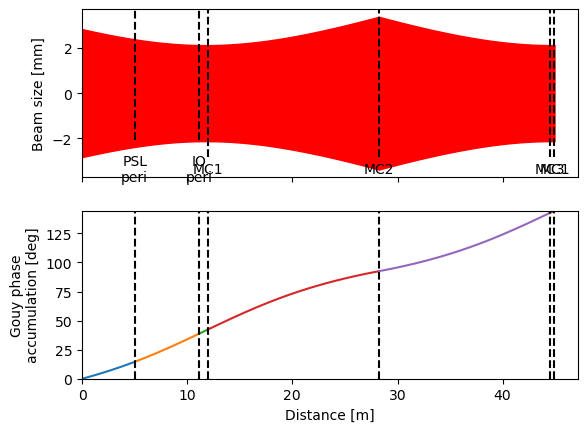

In [20]:
L_IOperi_MC1_HR = np.linalg.norm(bp_finesse['MC1_HR'].z - bp_finesse['IO_peri_top'].z)
L_PSLperi_IOperi = np.linalg.norm(PSL_to_IMC['IO_MB_M6'].pos - PSL_to_IMC['IO_peri_top'].pos)

L_laser_peri_inmodel = 5

model = finesse.Model()
model.parse(f"""
lambda(1064n)

# Laser
l L0 P=1

# Gaussian beam definition — note: port is L0.p1, not just L0
# gauss G1 L0.p1.o 1064n w0=0.547672e-3 z=-1  
            
# Space before lens
s s_L0_PSLperi L0.p1 PSL_peri.p1 L={L_laser_peri_inmodel}
s s_PSLperi_IOperi PSL_peri.p2 IO_peri.p1 L={L_PSLperi_IOperi}
s s_IOperi_MC1 IO_peri.p2 MC1.p1 L={L_IOperi_MC1_HR}


# Space after lens
s sMC1MC2 MC1.p3 MC2.p1 L={L_MC1_MC2}
s sMC2MC3 MC2.p2 MC3.p1 L={L_MC1_MC2}
s sMC3MC1 MC3.p2 MC1.p4 L={L_MC1_MC3}

# Dummy mirror to terminate the beam path
m PSL_peri 1 0
m IO_peri 1 0
bs MC1 0.99 0.01
bs MC2 1 0 Rc={R_MC2}
bs MC3 0.99 0.01

cav IMC MC1.p3
""")


# ビーム伝搬パス：レーザーから dummy mirror M1 まで
path = model.path(model.L0.p1, model.MC1.p4)

# プロパゲーション計算
ps = model.propagate_beam(path=path)
data = ps.all_segments('beamsize','gouy',add_gouy=True,w_scale=1,npts=2000,resolution='equal')
zz_finesse_old,bs_finesse_old,gouy_finesse_old = [],[],[]

for zs, segd in data.values():
    zz_finesse_old = np.concatenate([zz_finesse_old,zs])
    bs_finesse_old = np.concatenate([bs_finesse_old,segd['beamsize']])
    gouy_finesse_old = np.concatenate([gouy_finesse_old,segd['gouy']])


# プロット
fig,axs = ps.plot(
    name_xoffsets={"LENS": 15},
)

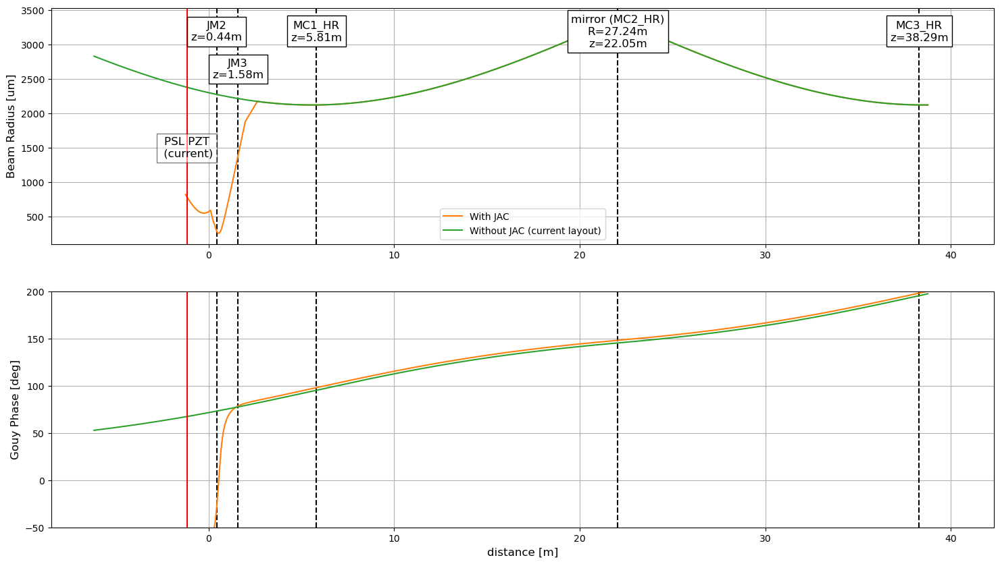

In [21]:
ofs_old = bp_finesse['MC1_HR'].z - L_IOperi_MC1_HR - L_PSLperi_IOperi - L_laser_peri_inmodel
IMC_mm_bp_copy = copy.deepcopy(IMC_mm_bp)
for comp in ['IMC waist','MC1_AR']:
    IMC_mm_bp_copy[comp].plot=False
fig,ax,_ = IMC_mm_bp_copy.plot(zz=zz_IMC_MM,verbose=['component'],)
ax[0].plot(zz_finesse-1.25,bs_finesse*1e6,label='With JAC')
ax[0].plot(zz_finesse_old+ofs_old,bs_finesse_old*1e6,label='Without JAC (current layout)')
ax[0].lines[0].set_visible(False)
ax[1].lines[0].set_visible(False)
ax[0].collections[0].remove()
ax[1].collections[0].remove()

ax[1].plot(zz_finesse-1.25,gouy_finesse-135)
ax[1].plot(zz_finesse_old+ofs_old,gouy_finesse_old+52.8)
ax[1].set_ylim([-50,200])

# current PZT
ax[0].axvline(x=ofs_old+5, color='red', linestyle='-')
ax[1].axvline(x=ofs_old+5, color='red', linestyle='-')
ax[0].legend()
ax[0].text(ofs_old+5, 1500, 'PSL PZT\n (current)', fontsize=12, ha='center', va='center',
                             bbox=dict(facecolor='white', alpha=0.5))
# ax[0].set_xlim(*xlim)
# ax[1].set_xlim(ax[0].get_xlim())
# ax[0].set_ylim(*ylim_bs)
fig.savefig('Figs/LHO/gouy_PSLPZT.png')

In [22]:
# 集計: HAM1テーブル基準でのJAC_REFLコンポーネント位置一覧
from pathlib import Path
import math

if 'JAC_REFL' not in globals():
    raise RuntimeError('JAC_REFL が定義されていません。先に JAC_REFL を構築するセルを実行してください。')

ham1_origin = HAM1_ISI_center[site]
global_origin = JAC_REFL.origin_in_global

header = (
    'name',
    'x_HAM1 [mm]',
    'y_HAM1 [mm]',
    'z_HAM1 [mm]',
    'x_global [mm]',
    'y_global [mm]',
    'z_global [mm]',
    'theta[deg]',
)
rows = []
for comp in JAC_REFL.component_list:
    pos_local = getattr(comp, 'pos', None)
    theta = getattr(comp, 'theta', None)
    if (pos_local is None) or (theta is None):
        row = [comp.name] + [float('nan')] * 7
    else:
        pos_local = np.asarray(pos_local, dtype=float)
        pos_global = pos_local + global_origin
        pos_ham1 = pos_global - ham1_origin
        row = [comp.name] + pos_ham1.tolist() + pos_global.tolist() + [theta]
    rows.append(row)

print_comp_list = [
    'JAC_M1','JAC_M2','JM1','JAC_IN','JAC_L1','JM2','JM3',
    'JAC_L2','JAC_L3','JAC_M3','JAC_M4','JAC_M5','JACR_M1',
    'JACR_M2','ISC_EOM','JACT_PD','JACT_BS1'
]

# 表示が不要なら次の2行は削除しても OK
print(f"{header[0]:<20}{header[1]:>15}{header[2]:>15}{header[3]:>15}{header[4]:>15}{header[5]:>15}{header[6]:>15}{header[7]:>15}")

clip_rows = []
for name, *values in rows:
    if name not in print_comp_list:
        continue

    formatted = []
    for idx, val in enumerate(values):
        if not math.isfinite(val):
            formatted.append('nan')
        elif idx < 6:  # x/y/z 系は m→mm 換算
            formatted.append(f"{val * 1000:.1f}")
        else:         # theta だけは度数で
            formatted.append(f"{val:.2f}")
    clip_rows.append([name] + formatted)

    # 表示が必要ならここで print
    print(f"{name:<20}{formatted[0]:>15}{formatted[1]:>15}{formatted[2]:>15}"
          f"{formatted[3]:>15}{formatted[4]:>15}{formatted[5]:>15}{formatted[6]:>15}")

# CSV 保存はこれまで通り
output_dir = Path('output') / site
output_dir.mkdir(parents=True, exist_ok=True)
csv_path = output_dir / 'JAC_REFL_component_positions_HAM1.csv'
with csv_path.open('w', newline='') as f:
    writer = csv.writer(f)
    writer.writerow(header)
    writer.writerows(rows)

print(f"\nSaved {len(rows)} entries to {csv_path.resolve()}")

# pandas があればクリップボードへコピー
try:
    import pandas as pd
except ImportError:
    pd = None

if pd is not None:
    if clip_rows:
        df = pd.DataFrame(clip_rows, columns=header)
        df.to_clipboard(index=False, excel=True)
        print('Copied component position table to clipboard.')
    else:
        print('print_comp_list に該当する行が無かったため、クリップボードへのコピーをスキップしました。')
else:
    print('pandas が見つからなかったため、クリップボードへのコピーをスキップしました。')



name                    x_HAM1 [mm]    y_HAM1 [mm]    z_HAM1 [mm]  x_global [mm]  y_global [mm]  z_global [mm]     theta[deg]
JAC_M1                       -818.0            0.0          316.6       -23544.8            0.0          126.9           0.00
JAC_M2                       -818.0            0.0          101.6       -23544.8            0.0          -88.1           0.00
JM1                          -818.0          233.7          101.6       -23544.8          233.7          -88.1         -45.00
JAC_IN                       -519.7          233.7          101.6       -23246.5          233.7          -88.1           0.00
JAC_L1                         79.9          233.7          101.6       -22646.9          233.7          -88.1           0.00
ISC_EOM                       270.3          234.6          101.6       -22456.5          234.6          -88.1           2.30
JM2                           416.3          245.5          101.6       -22310.5          245.5          -88.1        